## Business Case: 


Bank GoodCredit wants to predict cred score for current credit card 
customers. The cred score will denote a customer’s credit worthiness 
and help the bank in reducing credit default ris
.-  
Target variable → Bad_la1. b1. el
0 – Customer has Good credit his2. t2. ory
1 – Customer has Bad credit history (falls into 30 DPD + bucket)

# PROJECT GOAL:

Build a model with the data provided 
1. Data exploration insights – what did you find and what decision   
did you take?
2. Feature matrix - List of features selected with gain
3. Model evaluation - Gini and rank ordering

In [7]:
import pandas as pd
import time
from datetime import date
import numpy as np
import matplotlib.pyplot as plt
import warnings
import seaborn as sns
import datetime as dt
%matplotlib inline

warnings.filterwarnings("ignore")
pd.set_option('display.max_columns', None)

In [8]:
%matplotlib inline

In [9]:
acc = pd.read_csv('Cust_Account.csv')
enq = pd.read_csv('Cust_Enquiry.csv')
df = pd.read_csv('Cust_Demographics.csv')


In [10]:
enq.columns

Index(['dt_opened', 'customer_no', 'upload_dt', 'enquiry_dt', 'enq_purpose',
       'enq_amt'],
      dtype='object')

In [11]:
enq.head()

,dt_opened,customer_no,upload_dt,enquiry_dt,enq_purpose,enq_amt
0,18-Apr-15,1,21-Apr-15,19-Dec-14,2.0,3500000.0
1,18-Apr-15,1,21-Apr-15,05-Mar-14,5.0,500000.0
2,18-Apr-15,1,21-Apr-15,05-Mar-14,0.0,50000.0
3,18-Apr-15,1,21-Apr-15,22-Feb-14,10.0,50000.0
4,18-Apr-15,1,21-Apr-15,11-Jun-13,10.0,1000.0


# Creating suggested features

## payment_history_avg_dpd_0_29_bucket

In [12]:
# Function to calculate count of accounts in 0-29 DPD bucket
def count_accounts_in_dpd_0_29(payment_history):
    count = sum(1 for dpd in payment_history if dpd.isdigit() and 0 <= int(dpd) <= 29)
    return count

# Replace NaNs with empty strings
acc.fillna({'paymenthistory1': '', 'paymenthistory2': ''}, inplace=True)

# Calculate mean count of accounts in 0-29 DPD bucket
acc['payment_history_avg_dpd_0_29_bucket'] = acc.apply(lambda row: count_accounts_in_dpd_0_29(row['paymenthistory1'] + row['paymenthistory2']), axis=1)



In [13]:
#Creating acc_dpd to merge with dataframe "df"
#1. grouping by customer no for the feature 'payment_history_avg_dpd_0_29_bucket' with mean aggregate
acc_dpd = acc.groupby('customer_no')['payment_history_avg_dpd_0_29_bucket'].mean().reset_index()
#2. Rounding 'payment_history_avg_dpd_0_29_bucket' values to 2decemal values
acc_dpd['payment_history_avg_dpd_0_29_bucket'] = acc_dpd['payment_history_avg_dpd_0_29_bucket'].round(2)
#Merging acc_dpd with dataframe df
df = pd.merge(df, acc_dpd, on = 'customer_no', how = 'left')
#Filling missing values with 0
df['payment_history_avg_dpd_0_29_bucket'].fillna(0.0, inplace = True)

## min_months_last_30_plus

In [14]:
#Converting into datetime objects
acc['last_paymt_dt'] = pd.to_datetime(acc['last_paymt_dt'])
acc['opened_dt'] = pd.to_datetime(acc['opened_dt'])
acc['months_passed'] = (acc['last_paymt_dt'] - acc['opened_dt']) // pd.Timedelta('30 days')

min_month_last_30_plus = acc.groupby('customer_no')['months_passed'].min().reset_index()
#Renaming the columns
min_month_last_30_plus.columns = ['customer_no', 'min_months_last_30_plus']

#  Merge with the original dataframe (df)
df = pd.merge(df, min_month_last_30_plus, on = 'customer_no', how = 'left')
df['min_months_last_30_plus'].fillna(0.0, inplace = True)

### count_enquiry_recency_365

In [15]:
#Coverting objects into datetime features 
enq['enquiry_dt'] = pd.to_datetime(enq['enquiry_dt'])
enq['dt_opened']  = pd.to_datetime(enq['dt_opened'])
#
enq['count_enquiry_recency_365'] = enq['dt_opened'] -  enq['enquiry_dt']


#Here we need no.of enquries made in past 365days

enq2 = enq[enq['count_enquiry_recency_365']<='365days'].groupby('customer_no')['count_enquiry_recency_365'].count().reset_index()
enq2['count_enquiry_recency_365'] = enq2['count_enquiry_recency_365'].fillna(0)

#Merging the dataframe df with enq2
df = pd.merge(df,enq2, on = 'customer_no' , how = 'left')
df['count_enquiry_recency_365'].fillna(0.0, inplace = True)

### count_enquiry_recency_90 

In [16]:
enq['count_enquiry_recency_90'] = enq['dt_opened'] -  enq['enquiry_dt'] 
#Here we need no.of enquries made in past 365days
enq2 = enq[enq['count_enquiry_recency_90']<='90days'].groupby('customer_no')['count_enquiry_recency_90'].count().reset_index()
enq2['count_enquiry_recency_90'] = enq2['count_enquiry_recency_90'].fillna(0)

df = pd.merge(df,enq2, on = 'customer_no', how = 'left' )
df['count_enquiry_recency_90'].fillna(0.0,inplace = True)


### mean_diff_open_enquiry_dt

In [17]:
enq['mean_diff_open_enquiry_dt'] = enq['dt_opened'] -  enq['enquiry_dt'] 

#average difference between enquiry dt_opened date 
#and enquiry date
enq2 = enq.groupby('customer_no')['mean_diff_open_enquiry_dt'].mean().reset_index()
enq2['mean_diff_open_enquiry_dt'] = enq2['mean_diff_open_enquiry_dt'].dt.days
enq2['mean_diff_open_enquiry_dt'] = enq2['mean_diff_open_enquiry_dt'].fillna(0)

df = pd.merge(df,enq2, on = 'customer_no', how = 'left' )
df['mean_diff_open_enquiry_dt'].fillna(0,inplace = True)



### mean_diff_lastpaymt_opened_dt

In [18]:
acc['opened_dt'] = pd.to_datetime(acc['opened_dt'])
acc['last_paymt_dt'] = pd.to_datetime(acc['last_paymt_dt'])

acc['mean_diff_lastpaymt_opened_dt'] = acc['last_paymt_dt'] - acc['opened_dt']  

acc2 = acc.groupby('customer_no')['mean_diff_lastpaymt_opened_dt'].mean().reset_index()
acc2['mean_diff_lastpaymt_opened_dt'] = acc2['mean_diff_lastpaymt_opened_dt'].dt.days
acc2['mean_diff_lastpaymt_opened_dt'] = acc2['mean_diff_lastpaymt_opened_dt'].fillna(0)

df = pd.merge(df, acc2, on = 'customer_no', how = 'left')
df['mean_diff_lastpaymt_opened_dt'].fillna(0.0, inplace =True)


### payment_history_mean_length

In [19]:
acc['paymenthistory1'] = acc['paymenthistory1'].fillna('')  # Replace NaN values with empty string
acc['payment_history_mean_length'] = acc['paymenthistory1'].apply(lambda x: len(str(x)) if isinstance(x, str) else 0)


In [20]:
acc2 = acc.groupby('customer_no')['payment_history_mean_length'].mean().reset_index()
acc2['payment_history_mean_length'] = acc2['payment_history_mean_length'].round()
acc2['payment_history_mean_length'] = acc2['payment_history_mean_length'].fillna(0)

df = pd.merge(df, acc2,on = 'customer_no', how = 'left')
df['payment_history_mean_length'].fillna(0.0, inplace =True)
df.head()

,dt_opened,customer_no,entry_time,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,feature_33,feature_34,feature_35,feature_36,feature_37,feature_38,feature_39,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49,feature_50,feature_51,feature_52,feature_53,feature_54,feature_55,feature_56,feature_57,feature_58,feature_59,feature_60,feature_61,feature_62,feature_63,feature_64,feature_65,feature_66,feature_67,feature_68,feature_69,feature_70,feature_71,feature_72,feature_73,feature_74,feature_75,feature_76,feature_77,feature_78,feature_79,Bad_label,payment_history_avg_dpd_0_29_bucket,min_months_last_30_plus,count_enquiry_recency_365,count_enquiry_recency_90,mean_diff_open_enquiry_dt,mean_diff_lastpaymt_opened_dt,payment_history_mean_length
0,18-Apr-15,1,13-Apr-15,Insignia,13-Apr-15,650.0,2.0,Card Setup,14.0,500000.0,NaN,NaN,NaN,Y,IS1,NaN,0.0,159,4284,4284,NaN,1.0,ADFPNXXXXX,03-Sep-65,98332XXXXX,N,@REDIFFMAIL.COM,1.0,2.0,NaN,Mumbai / Navi Mumbai / Thane,400610.0,1965.0,0.0,Self,Y,2.0,90000.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Mumbai,400059.0,@CODOGNOTTO.NET,PAN Card,ADFPNXXXXX,The Ratnakar Bank Ltd.,NaN,Y,State Bank of India,0.0,01-Jun-13,17-Jun-16,1.0,21.0,NaN,Y,Y,N,NaN,Y,1965-0,21.0,15.0,400610.0,0.0,2.0,90000.0,Nov-00,21.0,R,NaN,NaN,0000-00-00,0.0,98332XXXXX,1.0,N,0,25.83,11.0,1.0,0.0,1443.0,1496.0,34.0
1,21-Apr-15,2,21-Apr-15,Insignia,21-Apr-15,760.0,1.0,Card Setup,14.0,1200000.0,NaN,NaN,NaN,Y,IS1,NaN,0.0,91,B001,4077,NaN,1.0,AJWPRXXXXX,14-Jul-62,99455XXXXX,N,@GMAIL.COM,1.0,2.0,NaN,Bengaluru,560042.0,1969.0,0.0,Self,Y,2.0,1.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Bangalore,560042.0,NaN,PAN Card,AJWPRXXXXX,The Ratnakar Bank Ltd.,NaN,N,NaN,0.0,NaN,17-Jun-16,1.0,17.0,NaN,Y,Y,N,NaN,Y,1969-0,17.0,12.0,560042.0,0.0,2.0,1.0,Nov-00,17.0,R,NaN,NaN,0000-00-00,0.0,99455XXXXX,1.0,N,0,105.00,67.0,19.0,2.0,812.0,2035.0,60.0
2,22-Apr-15,3,21-Apr-15,Insignia,21-Apr-15,774.0,1.0,Card Setup,14.0,700000.0,NaN,NaN,NaN,Y,IS1,NaN,0.0,91,B001,4077,NaN,2.0,AFAPNXXXXX,10-Apr-66,98456XXXXX,N,@SHOBANARAYAN.COM,1.0,0.0,NaN,Bengaluru,560042.0,1966.0,0.0,Self,Y,2.0,1.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Bangalore,560042.0,NaN,PAN Card,AFAPNXXXXX,NaN,NaN,N,NaN,0.0,NaN,17-Jun-16,3.0,17.0,NaN,N,Y,N,NaN,Y,1966-0,17.0,12.0,560042.0,0.0,2.0,1.0,Nov-00,17.0,R,NaN,NaN,0000-00-00,0.0,98456XXXXX,1.0,N,0,108.00,81.0,0.0,0.0,438.0,2454.0,60.0
3,25-Apr-15,4,15-Apr-15,Insignia,20-Apr-15,770.0,1.0,Card Setup,14.0,500000.0,NaN,NaN,NaN,Y,IS1,NaN,0.0,157,5107,5107,NaN,1.0,AAAPDXXXXX,16-Apr-64,98220XXXXX,N,@VSNL.COM,1.0,3.0,NaN,Pune,411001.0,1988.0,0.0,Self,Y,2.0,100000.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Pune,411026.0,@ALBAJ.COM,PAN Card,AAAPDXXXXX,The Ratnakar Bank Ltd.,NaN,Y,HDFC Bank,0.0,NaN,17-Jun-16,1.0,21.0,NaN,Y,Y,N,NaN,Y,1988-0,21.0,16.0,411001.0,0.0,2.0,100000.0,Nov-00,21.0,R,NaN,NaN,6/15/65,1.0,98220XXXXX,1.0,N,0,57.00,11.0,0.0,0.0,1920.0,2757.0,44.0
4,06-May-15,5,30-Apr-15,Insignia,NaN,NaN,3.0,Card Setup,14.0,500000.0,NaN,NaN,NaN,Y,IS1,NaN,0.0,100,D016,4564,NaN,1.0,ABEPSXXXXX,03-Jan-54,98111XXXXX,N,@REDIFFMAIL.COM,1.0,3.0,NaN,Gurgaon,122009.0,1995.0,0.0,Self,Y,2.0,300000.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Gurgaon,122009.0,NaN,PAN Card,ABEPSXXXXX,The Ratnakar Bank Ltd.,NaN,N,NaN,0.0,NaN,17-Jun-16,1.0,13.0,NaN,Y,Y,N,NaN,Y,1995-0,13.0,3.0,122009.0,0.0,2.0,300000.0,Nov-00,13.0,R,NaN,NaN,0000-00-00,0.0,98111XXXXX,1.0,N,0,48.00,8.0,0.0,0.0,1497.0,678.0,44.0


### Ratio_currbalance_creditlimit

In [21]:
total_cur_bal_amount = acc.groupby('customer_no')['cur_balance_amt'].sum().reset_index()
total_credit_limit = acc.groupby('customer_no')['creditlimit'].sum().reset_index()


total = pd.merge(total_credit_limit, total_cur_bal_amount, on ='customer_no', how = 'inner')
total.columns = ['customer_no','total_credit_limit','total_cur_bal_amt' ]

total['Ratio_currbalance_creditlimit'] =  total['total_cur_bal_amt'] / total['total_credit_limit']

total.loc[total['Ratio_currbalance_creditlimit'] == -np.inf, 'Ratio_currbalance_creditlimit'] = 0
total.loc[total['Ratio_currbalance_creditlimit'] ==  np.inf, 'Ratio_currbalance_creditlimit'] = 0


In [22]:
total['Ratio_currbalance_creditlimit'].fillna(0.0, inplace = True)
total['Ratio_currbalance_creditlimit'] =total['Ratio_currbalance_creditlimit'].round()
total['Ratio_currbalance_creditlimit'] = total['Ratio_currbalance_creditlimit'].astype(int)


In [23]:

df = pd.merge(df, total[['customer_no', 'Ratio_currbalance_creditlimit']], on='customer_no', how='left')

df['Ratio_currbalance_creditlimit'].fillna(0.0, inplace =True)

### utilisation_trend 

In [24]:
mean_cur_bal_amt = acc.groupby("customer_no")["cur_balance_amt"].apply(lambda x: x.mean())
mean_credit_limit = acc.groupby("customer_no")["creditlimit"].apply(lambda x: x.mean())
mean_cashlimit = acc.groupby("customer_no")["cashlimit"].apply(lambda x: x.mean())

In [25]:
acc2['utilisation_trend'] = df['Ratio_currbalance_creditlimit'] / (mean_cur_bal_amt / (mean_credit_limit + mean_cashlimit))


In [26]:
acc2.loc[acc2['utilisation_trend'] == -np.inf, 'utilisation_trend'] = 0
acc2.loc[acc2['utilisation_trend'] ==  np.inf, 'utilisation_trend'] = 0
acc2['utilisation_trend'] = acc2['utilisation_trend'].fillna(0.0)


In [27]:
df = pd.merge(df, acc2[['customer_no','utilisation_trend']], on ='customer_no', how = 'left' )
df['utilisation_trend'].fillna(0.0, inplace = True)

### max_freq_enquiry 

In [28]:
enq2 = enq.groupby('customer_no')['enq_purpose'].max().reset_index()
enq2['enq_purpose'].fillna(0, inplace = True)
enq2 = enq2.astype(int)
enq2.columns = ['customer_no', 'max_freq_enquiry']

In [29]:
df = pd.merge(df, enq2[['customer_no', 'max_freq_enquiry']], on = 'customer_no', how = 'left')
df['max_freq_enquiry'].fillna(0.0, inplace = True)

### total_diff_lastpaymt_opened_dt  

In [30]:
acc['total_diff_lastpaymt_opened_dt'] = acc['last_paymt_dt'] - acc['opened_dt']

In [31]:
acc2 = acc.groupby('customer_no')['total_diff_lastpaymt_opened_dt'].sum().reset_index()
acc2['total_diff_lastpaymt_opened_dt'] = acc2['total_diff_lastpaymt_opened_dt'].dt.days
acc2['total_diff_lastpaymt_opened_dt'] = acc2['total_diff_lastpaymt_opened_dt'].fillna(0)

In [32]:
df = pd.merge(df, acc2, on = 'customer_no', how = 'left')
df['total_diff_lastpaymt_opened_dt'].fillna(0.0, inplace = True)

# Data preprocessing
To start data preprocessing after EDA would be the better option, For this dataset, Data preprocessing is requried before EDA, cause the dataset is untidy

## Removing useless cols

### Missing cols

In [33]:
missing_cols = []
for col in df.columns:
    if (df.isnull().sum()[col] / len(df) > 0.75):
        missing_cols.append(col)


Removing the missing columns which have more than 75% missing values, the columns which have high missing values, can't possess valuble information, and we can't impute them as the percentage of missing values are higher

In [34]:
missing_cols

['feature_8',
 'feature_9',
 'feature_10',
 'feature_17',
 'feature_18',
 'feature_48',
 'feature_49',
 'feature_57',
 'feature_61',
 'feature_73',
 'feature_74']

In [35]:
df.drop(missing_cols, axis = 1, inplace = True)

### Finding Duplicate columns in a dataset

In [36]:
duplicated_cols = df.columns[df.T.duplicated()]
duplicated_cols

Index(['feature_59', 'feature_68', 'feature_69'], dtype='object')

Deleting duplicate columns is a computionally expensive

Here we are deleting columns, which are duplicated

In [37]:
#To find the duplicate features pairs
duplicated_pairs = []
for i, col1 in enumerate(df.columns):
    for col2 in df.columns[i + 1:]:
        if df[col1].equals(df[col2]):
            duplicated_pairs.append((col1, col2))

print("Duplicated column pairs:")
for pair in duplicated_pairs:
    print(pair)

Duplicated column pairs:
('feature_11', 'feature_59')
('feature_34', 'feature_68')
('feature_35', 'feature_69')


In [38]:
df.drop(duplicated_cols, axis = 1, inplace = True)

### To find constant feature in a dataset

In [39]:
constant_features = []
for col in df.columns:
    if df[col].nunique() ==1:
        constant_features.append(col)

constant_features

['feature_5', 'feature_6', 'feature_54']

These features have constant values over the dataset

In [40]:
df.drop(constant_features, axis = 1, inplace = True)

In [42]:
yorn = []
for col in df.columns:
    non_null_values = df[col].dropna()  # Filter out null values
    if all(value in ['Y', 'N'] for value in non_null_values.unique()):
        yorn.append(col)


There are few features, which unique values are y or n, so it's good to check if they're carrying the same information, or, if majority of information is carried by single unique value

In [43]:
yorn

['feature_11',
 'feature_23',
 'feature_33',
 'feature_50',
 'feature_58',
 'feature_60',
 'feature_62',
 'feature_79']

These features have unique values 'Y' or 'N'

In [44]:
import pandas as pd
value_counts_df = pd.DataFrame()
for col in yorn:
    value_counts = df[col].value_counts(normalize=True)
    
    value_counts_df[col] = value_counts

value_counts_df


,feature_11,feature_23,feature_33,feature_50,feature_58,feature_60,feature_62,feature_79
feature_11,,,,,,,,
Y,0.94682,0.09853,0.815627,0.52615,0.019095,0.013316,0.999791,0.000209
N,0.05318,0.90147,0.184373,0.47385,0.980905,0.986684,0.000209,0.999791


We can see that > 99% of the observations show one value, 0. Therefore, this features is almost constant. It doesn't carry any valuble information, so it's required to remove

In [45]:
remove_yorn = ['feature_58', 'feature_60', 'feature_62', 'feature_79']

In [46]:
df.drop(remove_yorn, axis = 1, inplace = True)

# EDA

## Goal-1
1. Data exploration insights – what did you find and what decision 
did you take?

In [49]:
df.head()

,dt_opened,customer_no,entry_time,feature_1,feature_2,feature_3,feature_4,feature_7,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,feature_33,feature_34,feature_35,feature_36,feature_37,feature_38,feature_39,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_50,feature_51,feature_52,feature_53,feature_55,feature_56,feature_63,feature_64,feature_65,feature_66,feature_67,feature_70,feature_71,feature_72,feature_75,feature_76,feature_77,feature_78,Bad_label,payment_history_avg_dpd_0_29_bucket,min_months_last_30_plus,count_enquiry_recency_365,count_enquiry_recency_90,mean_diff_open_enquiry_dt,mean_diff_lastpaymt_opened_dt,payment_history_mean_length,Ratio_currbalance_creditlimit,utilisation_trend,max_freq_enquiry,total_diff_lastpaymt_opened_dt
0,18-Apr-15,1,13-Apr-15,Insignia,13-Apr-15,650.0,2.0,500000.0,Y,IS1,NaN,0.0,159,4284,1.0,ADFPNXXXXX,03-Sep-65,98332XXXXX,N,@REDIFFMAIL.COM,1.0,2.0,NaN,Mumbai / Navi Mumbai / Thane,400610.0,1965.0,0.0,Self,Y,2.0,90000.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Mumbai,400059.0,@CODOGNOTTO.NET,PAN Card,ADFPNXXXXX,Y,State Bank of India,0.0,01-Jun-13,1.0,21.0,1965-0,21.0,15.0,400610.0,0.0,Nov-00,21.0,R,0000-00-00,0.0,98332XXXXX,1.0,0,25.83,11.0,1.0,0.0,1443.0,1496.0,34.0,7.0,0.0,10,14960.0
1,21-Apr-15,2,21-Apr-15,Insignia,21-Apr-15,760.0,1.0,1200000.0,Y,IS1,NaN,0.0,91,B001,1.0,AJWPRXXXXX,14-Jul-62,99455XXXXX,N,@GMAIL.COM,1.0,2.0,NaN,Bengaluru,560042.0,1969.0,0.0,Self,Y,2.0,1.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Bangalore,560042.0,NaN,PAN Card,AJWPRXXXXX,N,NaN,0.0,NaN,1.0,17.0,1969-0,17.0,12.0,560042.0,0.0,Nov-00,17.0,R,0000-00-00,0.0,99455XXXXX,1.0,0,105.00,67.0,19.0,2.0,812.0,2035.0,60.0,0.0,0.0,54,4070.0
2,22-Apr-15,3,21-Apr-15,Insignia,21-Apr-15,774.0,1.0,700000.0,Y,IS1,NaN,0.0,91,B001,2.0,AFAPNXXXXX,10-Apr-66,98456XXXXX,N,@SHOBANARAYAN.COM,1.0,0.0,NaN,Bengaluru,560042.0,1966.0,0.0,Self,Y,2.0,1.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Bangalore,560042.0,NaN,PAN Card,AFAPNXXXXX,N,NaN,0.0,NaN,3.0,17.0,1966-0,17.0,12.0,560042.0,0.0,Nov-00,17.0,R,0000-00-00,0.0,98456XXXXX,1.0,0,108.00,81.0,0.0,0.0,438.0,2454.0,60.0,0.0,0.0,1,2454.0
3,25-Apr-15,4,15-Apr-15,Insignia,20-Apr-15,770.0,1.0,500000.0,Y,IS1,NaN,0.0,157,5107,1.0,AAAPDXXXXX,16-Apr-64,98220XXXXX,N,@VSNL.COM,1.0,3.0,NaN,Pune,411001.0,1988.0,0.0,Self,Y,2.0,100000.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Pune,411026.0,@ALBAJ.COM,PAN Card,AAAPDXXXXX,Y,HDFC Bank,0.0,NaN,1.0,21.0,1988-0,21.0,16.0,411001.0,0.0,Nov-00,21.0,R,6/15/65,1.0,98220XXXXX,1.0,0,57.00,11.0,0.0,0.0,1920.0,2757.0,44.0,2.0,0.0,52,38600.0
4,06-May-15,5,30-Apr-15,Insignia,NaN,NaN,3.0,500000.0,Y,IS1,NaN,0.0,100,D016,1.0,ABEPSXXXXX,03-Jan-54,98111XXXXX,N,@REDIFFMAIL.COM,1.0,3.0,NaN,Gurgaon,122009.0,1995.0,0.0,Self,Y,2.0,300000.0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,Gurgaon,122009.0,NaN,PAN Card,ABEPSXXXXX,N,NaN,0.0,NaN,1.0,13.0,1995-0,13.0,3.0,122009.0,0.0,Nov-00,13.0,R,0000-00-00,0.0,98111XXXXX,1.0,0,48.00,8.0,0.0,0.0,1497.0,678.0,44.0,0.0,0.0,10,1357.0


### Dropping unwanted features

In [50]:
drop_list1 = ['dt_opened', 'customer_no','feature_2', 'entry_time','feature_20',  
              'feature_21', 'feature_22', 'feature_24','feature_29','feature_30','feature_39','feature_45', 'feature_47', 'feature_53', 'feature_63','feature_66','feature_70',
             'feature_75','feature_76' ,'feature_77' , 'feature_44', 'feature_13', 'feature_31' ]

The above features are dates, mail id's, etc are usless information to build a model, so it's required to remove those features

In [60]:
df.drop(drop_list1, axis = 1, inplace = True)

In [61]:

df.describe()

,feature_3,feature_4,feature_7,feature_14,feature_19,feature_25,feature_26,feature_34,feature_35,feature_40,feature_41,feature_42,feature_52,feature_55,feature_56,feature_64,feature_65,feature_67,feature_71,feature_78,Bad_label,payment_history_avg_dpd_0_29_bucket,min_months_last_30_plus,count_enquiry_recency_365,count_enquiry_recency_90,mean_diff_open_enquiry_dt,mean_diff_lastpaymt_opened_dt,payment_history_mean_length,Ratio_currbalance_creditlimit,utilisation_trend,max_freq_enquiry,total_diff_lastpaymt_opened_dt
count,21060.000000,23881.000000,2.388100e+04,16163.000000,23881.000000,23881.000000,23881.000000,23881.000000,2.388100e+04,23881.000000,23881.000000,23881.000000,2.388100e+04,23881.000000,23881.000000,23881.000000,23881.000000,23881.000000,23881.000000,23881.000000,23896.000000,23896.000000,23896.000000,23896.000000,23896.000000,23896.000000,23896.000000,23896.000000,23896.000000,2.389600e+04,23896.000000,23896.000000
mean,723.235945,2.321595,1.190705e+05,8.086618,1.049412,1.233910,0.725640,1.238851,3.278933e+04,3.348352,5.702609,0.154139,6.500073e+04,1.085717,13.337465,14.587454,157.609732,0.184373,14.539048,1.043214,0.042015,40.798913,6.161491,4.698611,1.053063,923.127553,662.937228,39.623535,4.635378,4.999062e+02,13.590852,5222.370146
std,37.318684,0.892838,7.752349e+04,5.625654,0.216731,0.423324,1.124986,0.430009,1.087860e+05,3.587043,4.159316,0.930806,1.008225e+05,0.388569,8.285993,9.518517,190.979066,0.387796,9.077906,0.224672,0.200628,20.674073,9.216441,4.690484,1.612604,573.982187,465.190974,12.476186,32.434557,1.209987e+05,10.374052,7237.945460
min,-1.000000,1.000000,0.000000e+00,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,1.000000,2.000000,2.000000,1.000000,0.000000,2.000000,1.000000,0.000000,0.000000,-143.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-104.000000,-3.726000e+06,0.000000,0.000000
25%,698.000000,1.000000,7.200000e+04,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000e+00,0.000000,1.000000,0.000000,0.000000e+00,1.000000,10.000000,10.000000,39.000000,0.000000,10.000000,1.000000,0.000000,26.570000,1.000000,2.000000,0.000000,483.000000,337.000000,34.000000,0.000000,0.000000e+00,10.000000,1129.750000
50%,721.000000,3.000000,1.040000e+05,12.000000,1.000000,1.000000,0.000000,1.000000,3.000000e+04,2.000000,6.000000,0.000000,5.000000e+04,1.000000,10.000000,10.000000,157.000000,0.000000,10.000000,1.000000,0.000000,39.750000,4.000000,3.000000,0.000000,774.000000,560.000000,41.000000,1.000000,0.000000e+00,10.000000,2770.000000
75%,745.000000,3.000000,1.390000e+05,12.000000,1.000000,1.000000,2.000000,1.000000,4.300000e+04,6.000000,10.000000,0.000000,1.000000e+05,1.000000,13.000000,21.000000,157.000000,0.000000,17.000000,1.000000,0.000000,54.000000,8.000000,6.000000,2.000000,1265.000000,881.000000,48.000000,3.000000,5.416383e+00,13.000000,6194.000000
max,896.000000,3.000000,1.217000e+06,12.000000,2.000000,2.000000,10.000000,3.000000,1.500000e+07,12.000000,11.000000,11.000000,3.777000e+06,4.000000,35.000000,35.000000,10008.000000,1.000000,35.000000,3.000000,1.000000,108.000000,283.000000,106.000000,27.000000,3466.000000,8517.000000,81.000000,2836.000000,1.816992e+07,59.000000,96440.000000


In [62]:
%matplotlib inline

Shape of your Data Set loaded: (23896, 50)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  26
    Number of Integer-Categorical Columns =  1
    Number of String-Categorical Columns =  10
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  5
    Number of Numeric-Boolean Columns =  4
    Number of Discrete String Columns =  2
    Number of NLP String Columns =  1
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    49 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification problem #####################
   Total columns > 3

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
feature_1,object,0.062772,0,,,"15 missing values. Impute them with mean, median, mode, or a constant value such as 123., 4 rare categories: ['RBL Bank Fun+', 'Insignia', 'Golf Card', 'Platinum Cricke']. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
feature_3,float64,11.868095,NA,-1.000000,896.000000,"2836 missing values. Impute them with mean, median, mode, or a constant value such as 123., Column has 319 outliers greater than upper bound (815.50) or lower than lower bound(627.50). Cap them or remove them."
feature_4,float64,0.062772,NA,1.000000,3.000000,"15 missing values. Impute them with mean, median, mode, or a constant value such as 123."
feature_7,float64,0.062772,NA,0.000000,1217000.000000,"15 missing values. Impute them with mean, median, mode, or a constant value such as 123., Column has 1445 outliers greater than upper bound (239500.00) or lower than lower bound(-28500.00). Cap them or remove them."
feature_11,object,0.062772,0,,,"15 missing values. Impute them with mean, median, mode, or a constant value such as 123., Mixed dtypes: has 2 different data types: object, float,"
feature_12,object,0.062772,0,,,"15 missing values. Impute them with mean, median, mode, or a constant value such as 123., 13 rare categories: Too many to list. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
feature_14,float64,32.361065,0,,,"7733 missing values. Impute them with mean, median, mode, or a constant value such as 123."
feature_15,object,0.096250,1,,,"23 missing values. Impute them with mean, median, mode, or a constant value such as 123., Mixed dtypes: has 2 different data types: object, float,, Possible high cardinality column with 364 unique values: Use hash encoding or text embedding to reduce dimension."
feature_16,object,0.112990,2,,,"27 missing values. Impute them with mean, median, mode, or a constant value such as 123., Mixed dtypes: has 2 different data types: object, float,, Possible high cardinality column with 522 unique values: Use hash encoding or text embedding to reduce dimension."
feature_19,float64,0.062772,0,,,"15 missing values. Impute them with mean, median, mode, or a constant value such as 123."


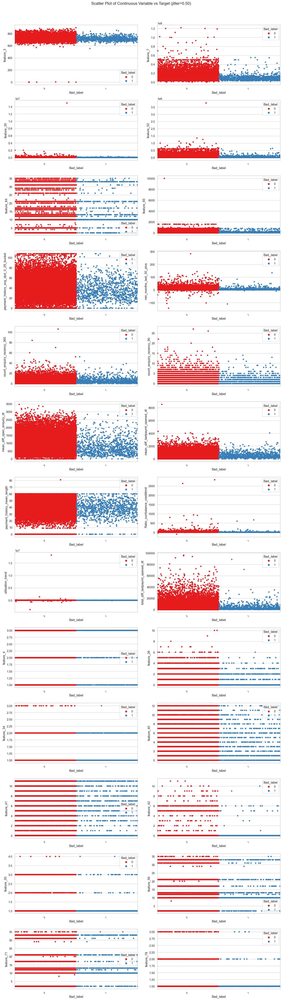

Total Number of Scatter Plots = 351


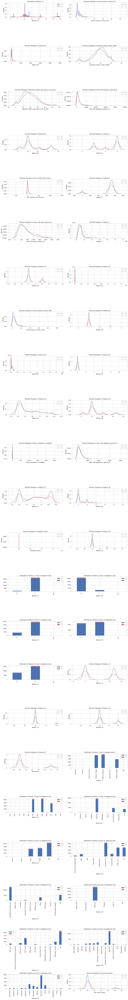

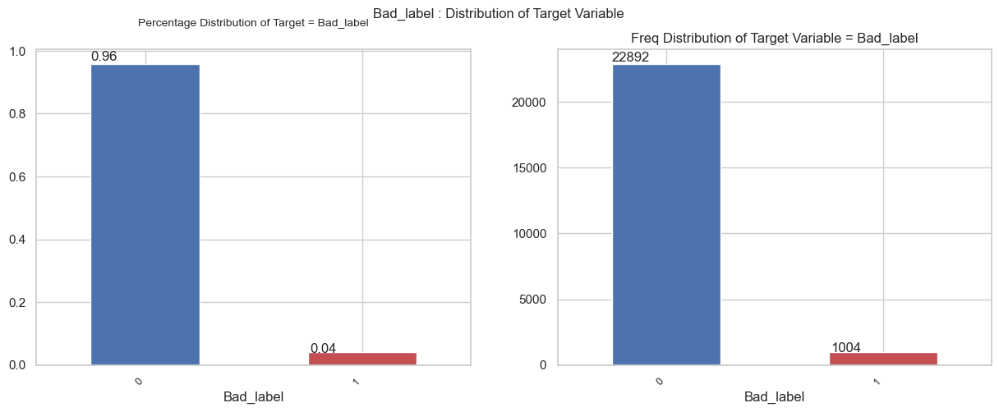

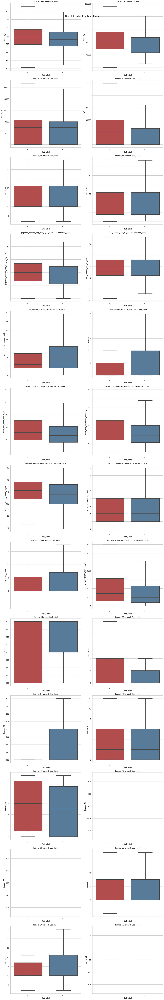

Could not draw some Heat Maps


<Figure size 2000x2000 with 0 Axes>

ValueError: Image size of 2000x110500 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2000x110500 with 442 Axes>

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     C:\Users\aadhi\AppData\Roaming\nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     C:\Users\aadhi\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     C:\Users\aadhi\AppData\Roaming\nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     C:\Users\aadhi\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     C:\Users\aadhi\AppData\Roaming\nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]   

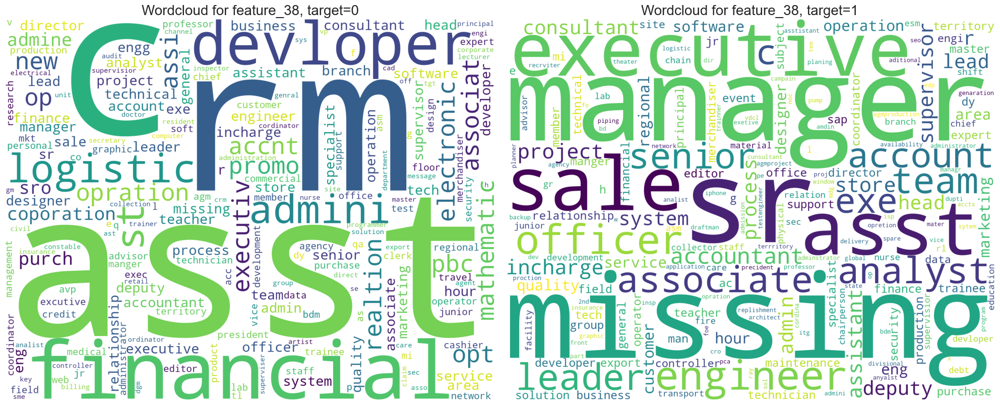

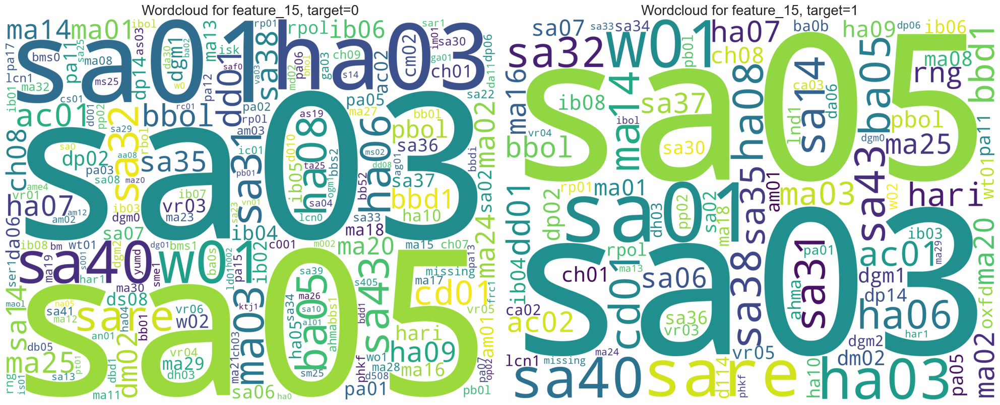

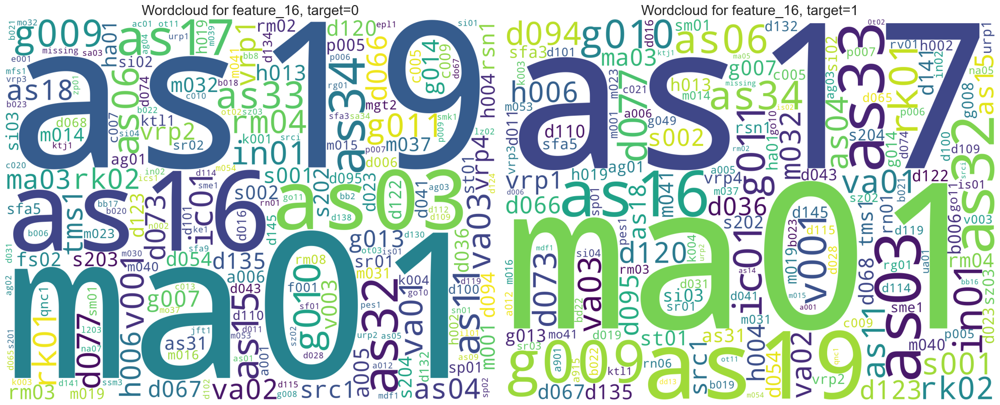

All Plots done
Time to run AutoViz = 421 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [63]:
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline
AV = AutoViz_Class()
dfte = AV.AutoViz(filename = '', sep=',', depVar='Bad_label', dfte=df, header=0, verbose=1, lowess=False,
                  chart_format='svg', max_rows_analyzed=150000, max_cols_analyzed=50, save_plot_dir=None)


## Insights
### Scatter Plot of Continuous variable vs target

1. In feature_3, the values of bad credit customers are less compared to good credit
2. In feature_7, the majority of values of bad credit customer is less than 3000
3. feature_35 and 52 are same as feature_7
4. majority of bad customer scores of features are less compared to good credit customers

### top 10 value counts of each feature (countplot)

In [67]:
cat_cols = [col for col in df.columns if df[col].dtype=='object']

In [68]:
len(cat_cols)

18

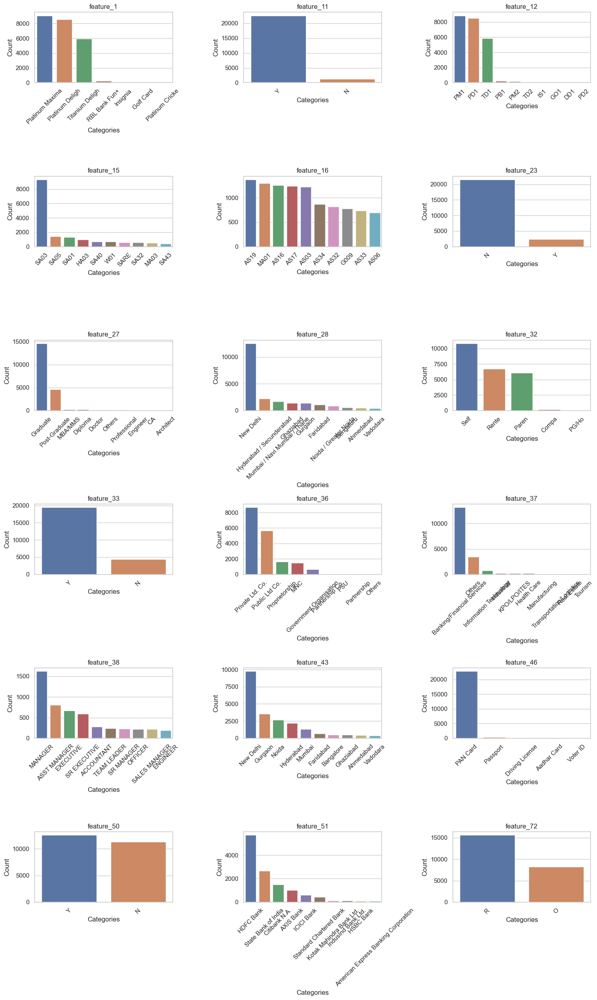

In [69]:
fig, axes = plt.subplots(6, 3, figsize=(15, 25), facecolor='white')

for i, col_name in enumerate(cat_cols):
    top_values = df[col_name].value_counts().head(10) 
    row = i // 3
    col = i % 3
    ax = axes[row, col]
    sns.barplot(x=top_values.index, y=top_values.values, ax=ax, palette='deep')
    ax.set_title(col_name)  # Set the column name as the title
    ax.set_xlabel('Categories')
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45)  #

plt.tight_layout()
plt.show()


The above plot is the count plot of features which are less than 10 value_counts(), few features has high cardinal data, displaying visually is very difficult

## Univariate analysis

In [70]:
distribution_cols = [col for col in df.columns if df[col].dtype != 'object']
len(distribution_cols)

32

In [71]:
distribution_cols.remove('utilisation_trend')


ploting utlisation trend taking lot of time for seaborn, so i'm terminating  this feature in univariate annalysis

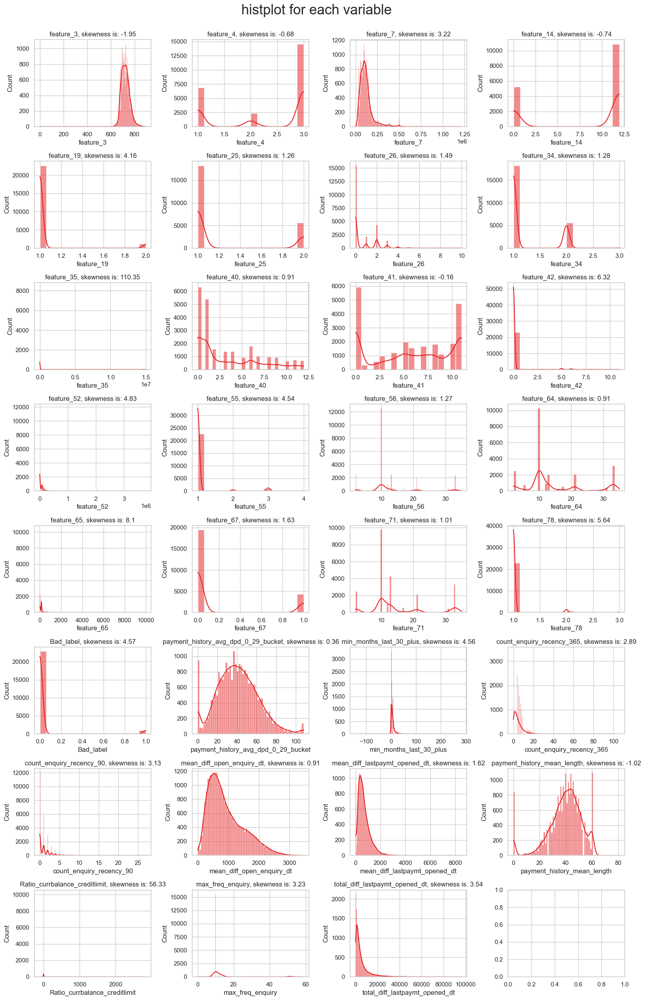

In [72]:
import matplotlib.pyplot as plt
import seaborn as sns

def histplots_custom(dataset, columns_list, rows, cols, suptitle):
    fig, axs = plt.subplots(rows, cols, figsize=(16, 25))
    fig.suptitle(suptitle, y=1, size=25)
    
    axs = axs.flatten()
    for i, data in enumerate(columns_list):
        sns.histplot(data=dataset[data], ax=axs[i], palette='deep' , kde = True)  
        axs[i].set_title(data + ', skewness is: ' + str(round(dataset[data].skew(axis=0, skipna=True), 2)))

histplots_custom(dataset=df, columns_list=distribution_cols, rows=8, cols=4, suptitle='histplot for each variable')
plt.tight_layout()
plt.show()


### Insights
1. Feature_3 is normally distributed but it has some outliers
2. feature_4 is descreate data with value 3 is more and 1 is less
3. feature_7 is right skewed and it has some outliers
4. feature_14 has two values 0 and 12
5. feature_19 also has two values 1 and 2, but there are more than 90% values are 1
6. feature_25 and feature_34 has only two values
7. feature_40 and feature_41 are discreate data, 0 to 12 and 0 to 10
8. total_diff_lastpaymt_opened_dt is highly right skewed
9. payment_history_avg_dpd_0_29_bucket is looking like normally distributed but the data is skewed towards 0, same as payment_history_mean_length, but it skewed towards 60
10. max_frequency and Ratio_currbalance_creditlimit are not looking like they're useful features

In [74]:
num_cols = [col for col in df.columns if df[col].dtype!='object']

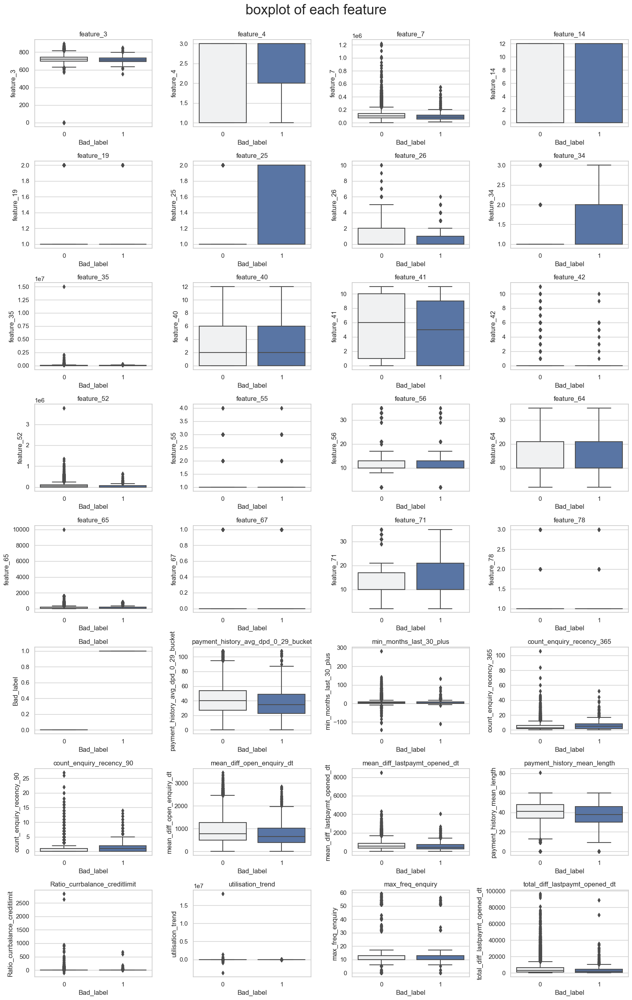

In [75]:
import matplotlib.pyplot as plt
import seaborn as sns

def histplots_custom(dataset, rows, cols, suptitle):
    fig, axs = plt.subplots(rows, cols, figsize=(16, 25))
    fig.suptitle(suptitle, y=1, size=25)
    
    for i, data in enumerate(dataset.columns):
        sns.boxplot(x='Bad_label', y=data, data=dataset, ax=axs[i // cols, i % cols], palette='light:b')  
        axs[i // cols, i % cols].set_title(data)

histplots_custom(dataset=df[num_cols], rows=8, cols=4, suptitle='boxplot of each feature')
plt.tight_layout()
plt.show()


### Barplot for low cardinal features


In [76]:
barplot = ['feature_1', 'feature_11','feature_23', 'feature_27', 'feature_33','feature_36', 'feature_37', 'feature_46', 'feature_50', 'feature_51', 'feature_72' ]

In [77]:
len(barplot)

11

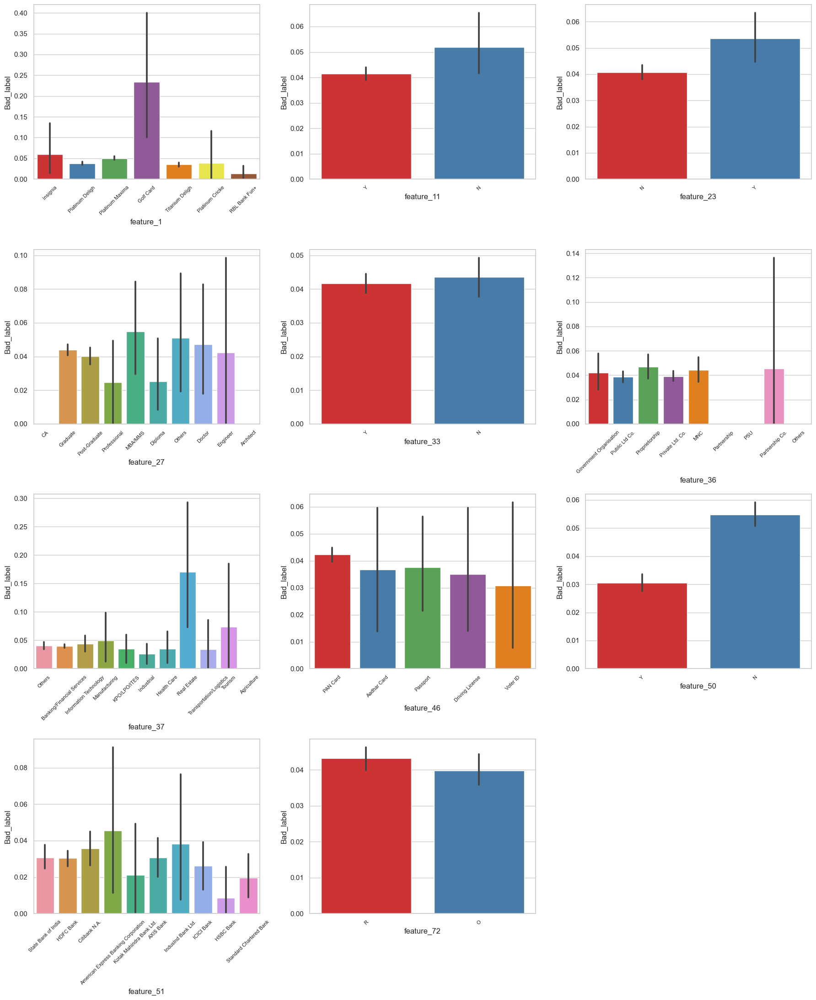

In [78]:
fig = plt.figure(figsize = (18,22), facecolor='white')
for i, col in enumerate(df[barplot], start = 1):
    ax = fig.add_subplot(4,3,i)
    sns.barplot(x = df[col], y = df['Bad_label'],ax = ax)
    plt.xticks(rotation=45)
    ax.tick_params(axis='x', labelsize=8) 
     
plt.tight_layout()
plt.show()

### Insights
1. The coustomers who possess golf card more likely to have bad credit history
2. If the feature_11 of customer is N, the creditworthy ness to be bad
3. Feature_23 is same as feature_1
4. In feature_37 realestate people likely to have more bad_credit
5. In feature_50 if the customer has n, there is a chance for bad credit

# Checking for outliers in a dataset

In [79]:
num_cols = [col for col in df.columns if df[col].dtype != 'object']
len(num_cols)

32

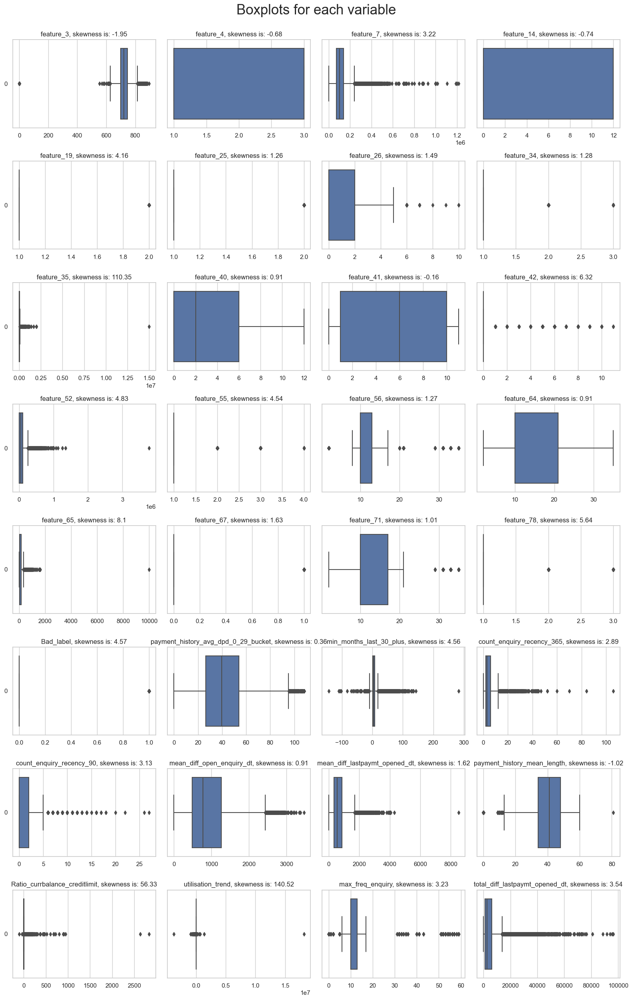

In [80]:
def boxplots_custom(dataset, columns_list, rows, cols, suptitle):
    fig, axs = plt.subplots(rows, cols, sharey=True, figsize=(16, 25))
    fig.suptitle(suptitle, y=1, size=25)
    axs = axs.flatten()
    for i, data in enumerate(columns_list):
        sns.boxplot(data=dataset[data], orient='h', ax=axs[i], palette='deep')  
        axs[i].set_title(data + ', skewness is: ' + str(round(dataset[data].skew(axis=0, skipna=True), 2)))

# Example usage:
boxplots_custom(dataset=df, columns_list=num_cols, rows=8, cols=4, suptitle='Boxplots for each variable')
plt.tight_layout()
plt.show()


We have a significant problems with outliers:

* huge outliers;

* higly skeved data;

* a lot of outliers.

Inter Quartile Range (IQR) is one of the most extensively used procedure for outlier detection and removal.

Procedure:

1. Find the first quartile, Q1.
2. Find the third quartile, Q3.
3. Calculate the IQR. IQR = Q3-Q1.
4. Define the normal data range with lower limit as Q1–1.5 IQR and upper limit as Q3+1.5 IQR.
  

In [81]:
# numerical cols 
outlier_cols = [col for col in df.columns if df[col].dtype!='object']
outlier_cols.remove('Bad_label')

### IQR-Method

In [82]:
def IQR_method (df,n,features):

    outlier_list = []
    
    for column in features:
        # 1st quartile (25%)
        Q1 = np.percentile(df[column], 25)
        # 3rd quartile (75%)
        Q3 = np.percentile(df[column],75)
        # Interquartile range (IQR)
        IQR = Q3 - Q1
        # outlier step
        outlier_step = 1.5 * IQR
        # Determining a list of indices of outliers
        outlier_list_column = df[(df[column] < Q1 - outlier_step) | (df[column] > Q3 + outlier_step )].index
        # appending the list of outliers 
        outlier_list.extend(outlier_list_column)
        
    # selecting observations containing more than x outliers
    outlier_list = Counter(outlier_list)        
    multiple_outliers = list( k for k, v in outlier_list.items() if v > n )
    
    # Calculate the number of records below and above lower and above bound value respectively
    out1 = df[df[column] < Q1 - outlier_step]
    out2 = df[df[column] > Q3 + outlier_step]
    
    print('Total number of deleted outliers is:', out1.shape[0]+out2.shape[0])
    
    return multiple_outliers

In [83]:
# detecting outliers
Outliers_IQR = IQR_method(df,1,outlier_cols)

# dropping outliers
df_out = df.drop(Outliers_IQR, axis = 0).reset_index(drop=True)

Total number of deleted outliers is: 2120


In [84]:
df_out.shape

(20055, 50)

In [85]:
df_out['Bad_label'].value_counts()

Bad_label
0    19228
1      827
Name: count, dtype: int64

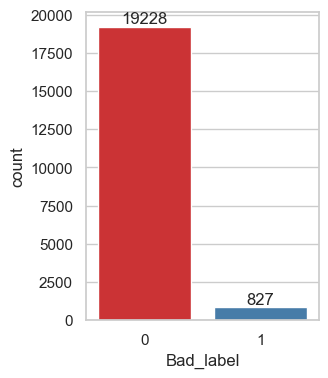

In [86]:
plt.figure(figsize=(3,4))
ax = sns.countplot(x='Bad_label',data=df_out)
for i in ax.containers:
    ax.bar_label(i,)

#### We deleted so many bad credit history counstomers from a dataframe!

After removing all the putliers, we are remained with this data

We stayed with only **827** bad credit history accounts in entire data frame!



## Handling missing data

In [87]:
missing_percentage = (df_out.isnull().sum() / len(df_out)) 
missing_percentage

feature_1                              0.000648
feature_3                              0.117327
feature_4                              0.000648
feature_7                              0.000648
feature_11                             0.000648
feature_12                             0.000648
feature_14                             0.322563
feature_15                             0.000947
feature_16                             0.001147
feature_19                             0.000648
feature_23                             0.000648
feature_25                             0.000648
feature_26                             0.000648
feature_27                             0.149289
feature_28                             0.000648
feature_32                             0.000648
feature_33                             0.000648
feature_34                             0.000648
feature_35                             0.000648
feature_36                             0.210721
feature_37                             0

All of the features 15 null rows, and it's required to drop those rows

<Axes: >

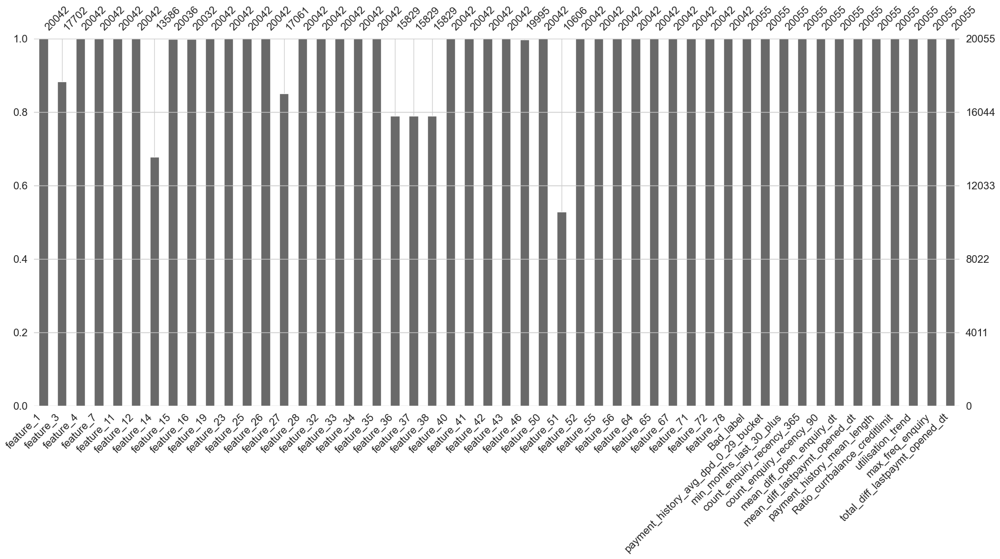

In [88]:
import missingno as msno 


msno.bar(df_out)

The bar chart above gives a quick graphical overview of the completeness of the dataset. We can see that feature_3, feature_14, feature_27, feature_36, feature_37, feature_38, and feature_51 columns have missing values. Next,it would make sense to find out the locations of the missing data.

### visuvalising the locations of missing data

<Axes: >

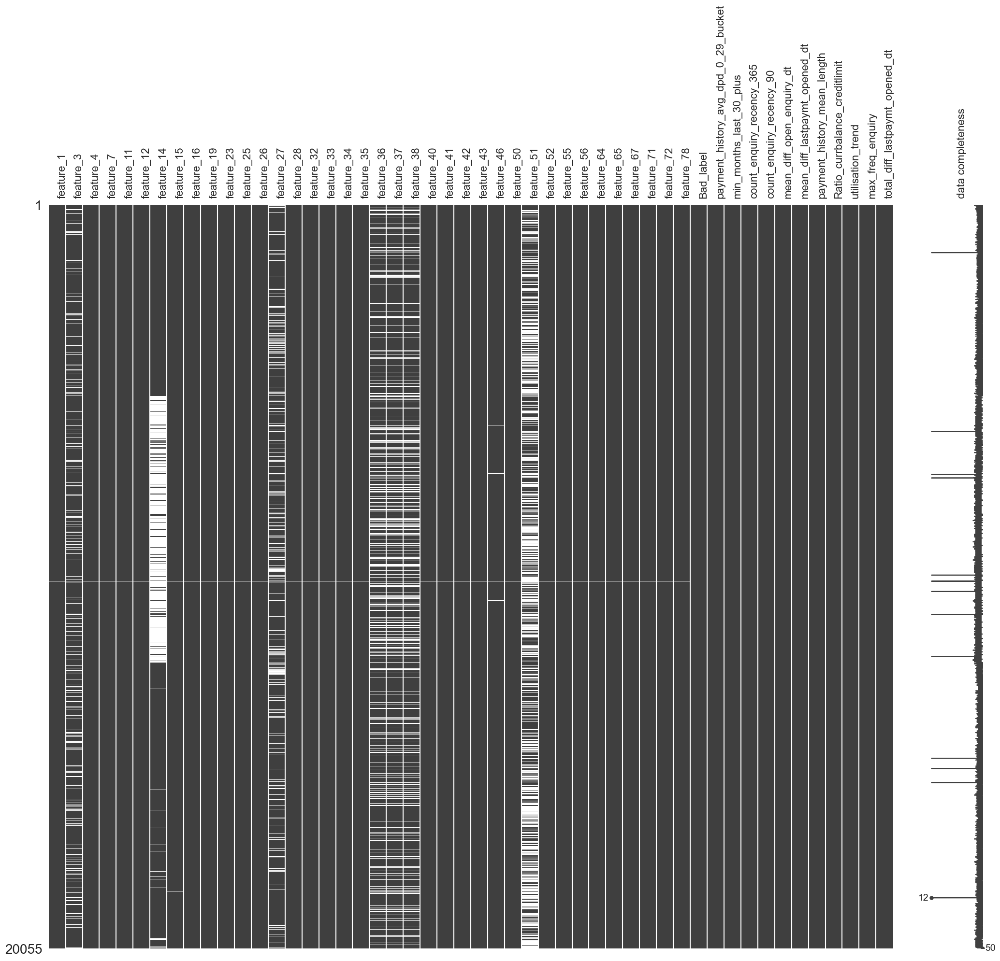

In [89]:
msno.matrix(df_out, labels=True, figsize=(25,20), label_rotation=90)

we can see that, feature_36, feature_37, feature_38 has missing values in same rows, it means they are not randomly missed, missing values are feature_14 are missed at particular region

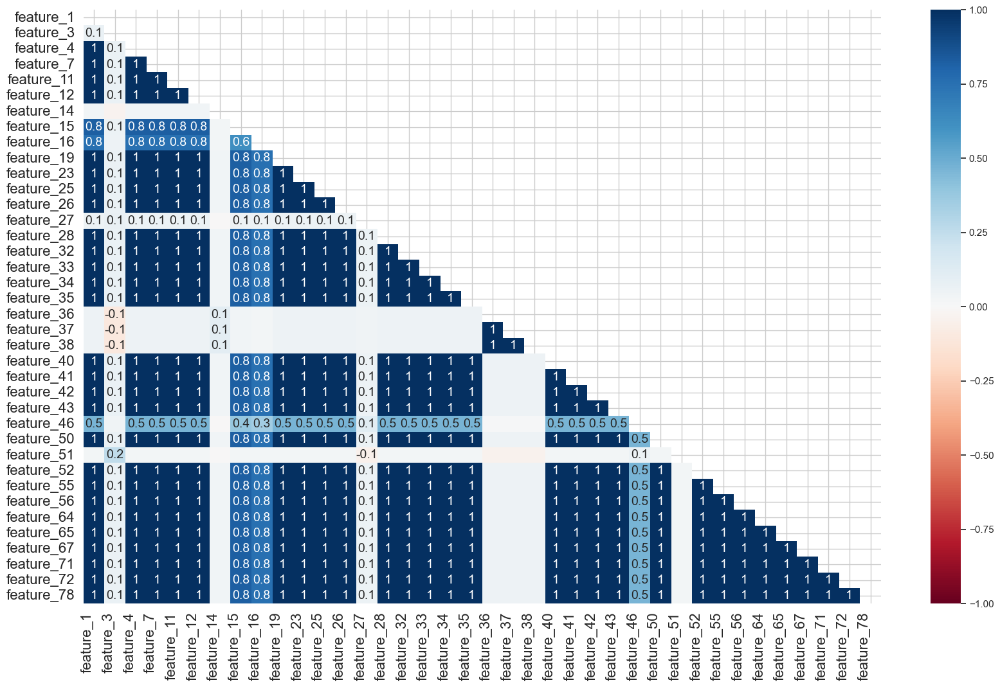

In [90]:
msno.heatmap(df_out, label_rotation=90);

all of the features are have 15null values, and we have seen the colinearity of missing values in above heatmax, so let's drop and check the colinearity of missing values of other features

feature_36, feature_37, feature_38 has high colinearity of missing values, it means that they're not randomly missed, missing values in one feature affect the other feature

Every feature have 15 missing values, so it's good to delete them

In [99]:
drop_null_index = df_out[df_out['feature_1'].isna()].index
df_out.drop(drop_null_index, axis = 0, inplace = True)
df_out.reset_index(drop=True, inplace=True)


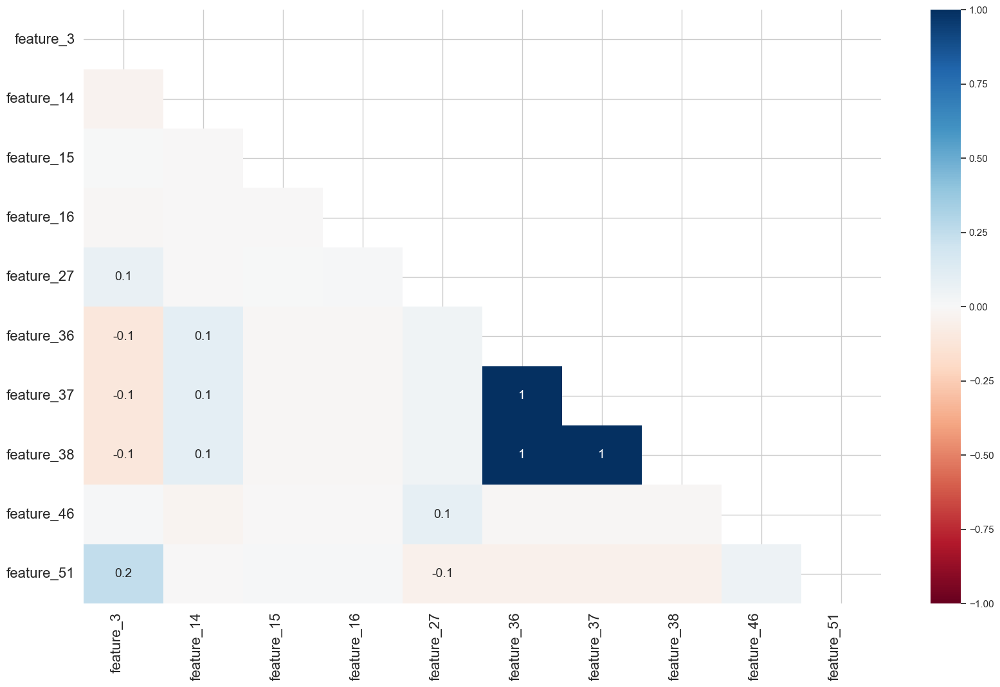

In [102]:
msno.heatmap(df_out, label_rotation=90);

feature_36, feature_37, feature_38 has high colinearity of missing values, it means that they're not randomly missed, missing values in one feature affect the other feature

### Using verstack NaN imputer 

## Verstack NaNImputer

Verstack NaNImputer is a data preprocessing tool designed to handle missing values within datasets. It operates within Jupyter Notebook, a popular platform for data analysis and visualization. NaNImputer specifically addresses NaN (Not a Number) values, which commonly arise in datasets due to incomplete data or data entry errors.

### Key Features:

- **Seamless Integration:** NaNImputer seamlessly integrates with Jupyter Notebook, allowing for easy implementation within data analysis workflows.
- **Customization Options:** Users have the flexibility to customize the imputation process based on their specific data requirements and analytical goals.
- **Robust Algorithms:** NaNImputer utilizes robust imputation algorithms to accurately estimate missing values, thereby preserving the integrity of the dataset.
- **Visual Feedback:** The tool provides visual feedback on the imputation process, enabling users to assess the impact of imputed values on their analyses.
- **Documentation and Support:** NaNImputer comes with comprehensive documentation and support resources to assist users in effectively utilizing the tool within their data analysis projects.

Overall, Verstack NaNImputer simplifies the task of handling missing values in datasets within the Jupyter Notebook environment, empowering data analysts and scientists to derive meaningful insights from their data with confidence.


In [103]:
from verstack import NaNImputer


In [104]:
imputer = NaNImputer()
df_imputed = imputer.impute(df_out)


 * Initiating NaNImputer.impute
     . Dataset dimensions:
     .. rows:         20042
     .. columns:      50
     .. mb in memory: 7.57
     .. NaN cols num: 10

   - Drop hopeless NaN cols
     . Missing values in feature_15 replaced by "Missing_data" string
     . Missing values in feature_16 replaced by "Missing_data" string
     . Missing values in feature_38 replaced by "Missing_data" string

   - Processing whole data for imputation
     . Processed 10 cols; 10 to go

   - Imputing single core 7 cols
     . Imputed (regression) - 2340     NaN in feature_3
     . Imputed (  binary  ) - 6456     NaN in feature_14
     . Imputed (multiclass) - 2981     NaN in feature_27
     . Imputed (multiclass) - 4213     NaN in feature_36
     . Imputed (multiclass) - 4213     NaN in feature_37
     . Imputed (multiclass) - 47       NaN in feature_46
     . Imputed (multiclass) - 9436     NaN in feature_51

   - Missing values after imputation: 0

Time elapsed for impute execution: 1 min 16.

The above library take care about  every missing value feature, it uses xg_boost to impute the features, and it removes missing value feature where percetage is greater than 50%

### Converting object into category 

This dataset has pincodes so let's change them to categorical so we could use encoding techniques

In [105]:
for col in df_imputed.columns:
    if df_imputed[col].dtype == 'object':
        df_imputed[col] = df_imputed[col].astype('category')


## Cardinity of the data

In [106]:
cat_cols = [col for col in df_imputed.columns if df_imputed[col].dtype == 'category']


In [107]:
def analyse_cats(df, cat_cols):
    d = pd.DataFrame()
    cl = [];u = [];s =[]; nans =[]
    for c in cat_cols:
        
        cl.append(c); u.append(df[c].unique());s.append(df[c].unique().size);nans.append(df[c].isnull().sum())
        
    d['"feat"'] = cl;d["uniques"] = u; d["cardinality"] = s; d["nans"] = nans
    return d

plt.style.use('fivethirtyeight')
catanadf = analyse_cats(df_imputed, cat_cols)
catanadf

,"""feat""",uniques,cardinality,nans
0,feature_1,"['Insignia', 'Platinum Deligh', 'Platinum Maxima', 'Golf Card', 'Titanium Deligh', 'Platinum Cricke', 'RBL Bank Fun+'] Categories (7, object): ['Golf Card', 'Insignia', 'Platinum Cricke', 'Platinum Deligh', 'Platinum Maxima', 'RBL Bank Fun+', 'Titanium Deligh']",7,0
1,feature_11,"['Y', 'N'] Categories (2, object): ['N', 'Y']",2,0
2,feature_12,"['IS1', 'IS2', 'PD1', 'PM1', 'GO1', ..., 'DD2', 'PM4', 'PD2', 'PB1', 'PB2'] Length: 14 Categories (14, object): ['DD1', 'DD2', 'GO1', 'IS1', ..., 'PM2', 'PM4', 'TD1', 'TD2']",14,0
3,feature_15,"['159', '100', '88', '141', '155', ..., 'BM50', 'DD11', 'P4KF', 'G040', 'PA13'] Length: 323 Categories (323, object): ['1', '10', '100', '102', ..., 'ha07', 'ma03', 'sa01', 'sa03']",323,0
4,feature_16,"['4284', 'D016', '5785', '3140', 'D068', ..., 'D161', 'W01', 'BB17', 'H026', 'SCR1'] Length: 472 Categories (472, object): ['0T01', '0T02', '123', '135', ..., 'ZP01', 'as06', 'g009', 'mo31']",472,0
5,feature_23,"['N', 'Y'] Categories (2, object): ['N', 'Y']",2,0
6,feature_27,"['Graduate', 'Post-Graduate', 'CA', 'MBA/MMS', 'Professional', 'Diploma', 'Others', 'Doctor', 'Engineer', 'Architect'] Categories (10, object): ['Architect', 'CA', 'Diploma', 'Doctor', ..., 'MBA/MMS', 'Others', 'Post-Graduate', 'Professional']",10,0
7,feature_28,"['Mumbai / Navi Mumbai / Thane', 'Gurgaon', 'New Delhi', 'Chennai', 'Vadodara', ..., 'Tiruchirapalli', 'Anand', 'Navsari', 'Bhavnagar', 'Indore'] Length: 59 Categories (59, object): ['24 Parganas', 'Agra', 'Ahmedabad', 'Anand', ..., 'Udaipur', 'Vadodara', 'Valsad', 'Warangal']",59,0
8,feature_32,"['Self', 'Paren', 'Compa', 'Rente', 'PG/Ho'] Categories (5, object): ['Compa', 'PG/Ho', 'Paren', 'Rente', 'Self']",5,0
9,feature_33,"['Y', 'N'] Categories (2, object): ['N', 'Y']",2,0


In [108]:
drop_cat_cols = ['feature_1', 'feature_12', 'feature_15', 'feature_16', 'feature_27', 'feature_28', 'feature_32', 'feature_36', 'feature_37', 'feature_38', 'feature_43', 'feature_46', 'feature_51']


Droping these high cardinal features, having them and creating a model doesn't give you better results, all of these features doesn't require to find credit worthiness of a customer

In [109]:
df_imputed.drop(drop_cat_cols, axis = 1, inplace = True)

## Importing packages

In [110]:
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold
from category_encoders import TargetEncoder
import category_encoders as ce
from sklearn.feature_selection import SelectFromModel, SelectKBest
from sklearn.preprocessing import LabelEncoder
from imblearn.ensemble import EasyEnsembleClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, \
                            confusion_matrix, classification_report, roc_auc_score, \
                            roc_curve, average_precision_score



from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression



from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC

# standard scaler
from sklearn.preprocessing import StandardScaler

# logistic regression model
from sklearn.linear_model import LogisticRegression

# metrics used for evaluation
from sklearn.metrics import f1_score, matthews_corrcoef


from yellowbrick.model_selection import RFECV


# Train test split

## Stratified splitting

Stratified splitting means that when you generate a training / validation dataset split, it will attempt to keep the same percentages of classes in each split.

These dataset divisions are usually generated randomly according to a target variable. However, when doing so, the proportions of the target variable among the different splits can differ, especially in the case of small datasets.

In [111]:
# Splitting data into features and target
X = df_imputed.drop('Bad_label', axis=1)
y = df_imputed['Bad_label']

In [112]:
# Splitting data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=4, stratify=y)

#### never mess up with your test set. Always split into test and train sets BEFORE Feature selection, scaling and sampling techniques


Oversampling, Scaling before splitting the data can allow the exact same observations to be present in both the test and train sets. This can allow model to simply memorize specific data points and cause overfitting and poor generalization to the test data. Data leakage can cause you to create overly optimistic if not completely invalid predictive models.

In [113]:
catcols = [col for col in X_train.columns if X_train[col].dtype=='category']
numcols = [col for col in X_train.columns if X_train[col].dtype!='category']

## Encoding

### One hot encoding

In [115]:
for col in catcols:
    X_train[col] = pd.get_dummies(X_train[col], drop_first=True).astype(int)
    X_test[col] = pd.get_dummies(X_test[col], drop_first=True).astype(int)

In [116]:
X_train.head()

,feature_3,feature_4,feature_7,feature_11,feature_14,feature_19,feature_23,feature_25,feature_26,feature_33,feature_34,feature_35,feature_40,feature_41,feature_42,feature_50,feature_52,feature_55,feature_56,feature_64,feature_65,feature_67,feature_71,feature_72,feature_78,payment_history_avg_dpd_0_29_bucket,min_months_last_30_plus,count_enquiry_recency_365,count_enquiry_recency_90,mean_diff_open_enquiry_dt,mean_diff_lastpaymt_opened_dt,payment_history_mean_length,Ratio_currbalance_creditlimit,utilisation_trend,max_freq_enquiry,total_diff_lastpaymt_opened_dt
2858,809.000000,1.0,150000.0,1,0.0,1.0,0,1.0,4.0,1,1.0,75647.0,5.0,11.0,0.0,0,0.0,1.0,21.0,21.0,15.0,0.0,21.0,1,2.0,0.00,0.0,1.0,0.0,1337.0,0.0,0.0,0.0,0.000000,10,0.0
1567,722.000000,3.0,123000.0,1,12.0,1.0,0,1.0,2.0,0,1.0,40000.0,3.0,11.0,0.0,1,67000.0,1.0,10.0,14.0,55.0,1.0,10.0,1,1.0,53.00,10.0,1.0,0.0,1000.0,679.0,51.0,1.0,108.896067,10,4078.0
16145,728.000000,3.0,123000.0,1,12.0,1.0,0,2.0,0.0,1,1.0,40000.0,1.0,7.0,0.0,1,75000.0,1.0,10.0,10.0,157.0,0.0,10.0,0,1.0,23.40,0.0,2.0,1.0,636.0,346.0,29.0,1.0,3.294217,10,1732.0
9078,636.004305,2.0,140000.0,1,0.0,1.0,0,2.0,0.0,0,1.0,1.0,4.0,8.0,0.0,1,25000.0,1.0,10.0,34.0,790.0,1.0,33.0,0,1.0,65.00,17.0,2.0,0.0,699.0,663.0,60.0,0.0,0.000000,10,1989.0
13237,715.000000,3.0,102000.0,1,12.0,1.0,0,2.0,0.0,0,1.0,43000.0,1.0,8.0,0.0,1,50000.0,1.0,10.0,5.0,588.0,1.0,10.0,0,1.0,75.75,15.0,7.0,2.0,778.0,1059.0,58.0,0.0,0.000000,10,4239.0


## Scaling

In [117]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


X_train = pd.DataFrame(data=X_train_scaled, columns=X_train.columns)


X_test = pd.DataFrame(data=X_test_scaled, columns=X_test.columns)

In [118]:
X_train.head()

,feature_3,feature_4,feature_7,feature_11,feature_14,feature_19,feature_23,feature_25,feature_26,feature_33,feature_34,feature_35,feature_40,feature_41,feature_42,feature_50,feature_52,feature_55,feature_56,feature_64,feature_65,feature_67,feature_71,feature_72,feature_78,payment_history_avg_dpd_0_29_bucket,min_months_last_30_plus,count_enquiry_recency_365,count_enquiry_recency_90,mean_diff_open_enquiry_dt,mean_diff_lastpaymt_opened_dt,payment_history_mean_length,Ratio_currbalance_creditlimit,utilisation_trend,max_freq_enquiry,total_diff_lastpaymt_opened_dt
0,2.124645,-1.500251,0.480902,0.239097,-0.934001,-0.227049,-0.326441,-0.586545,2.975571,0.489784,-0.514187,1.095463,0.424816,1.293679,-0.173321,-1.070529,-0.685435,-0.220287,0.960280,0.684195,-0.808463,-0.489784,0.727870,0.739587,4.255706,-2.041194,-0.925525,-0.880452,-0.727539,0.897019,-1.612237,-3.182006,-0.318681,-0.007071,-0.290274,-0.815497
1,0.237331,0.748267,0.101750,0.239097,1.070663,-0.227049,-0.326441,-0.586545,1.171516,-2.041715,-0.514187,0.230121,-0.132122,1.293679,-0.173321,0.934118,0.054111,-0.220287,-0.386642,-0.051286,-0.583187,2.041715,-0.490391,0.739587,-0.197772,0.697762,0.807530,-0.880452,-0.727539,0.253702,0.252848,0.961828,-0.201814,-0.006314,-0.290274,0.009563
2,0.367491,0.748267,0.101750,0.239097,1.070663,-0.227049,-0.326441,1.704898,-0.632539,0.489784,-0.514187,0.230121,-0.689059,0.302161,-0.173321,0.934118,0.142415,-0.220287,-0.386642,-0.471561,-0.008731,-0.489784,-0.490391,-1.352105,-0.197772,-0.831919,-0.925525,-0.611000,0.073273,-0.441158,-0.661841,-0.825708,-0.201814,-0.007048,-0.290274,-0.465079
3,-1.628196,-0.375992,0.340475,0.239097,-0.934001,-0.227049,-0.326441,1.704898,-0.632539,-2.041715,-0.514187,-0.740868,0.146347,0.550041,-0.173321,0.934118,-0.409485,-0.220287,-0.386642,2.050089,3.556274,2.041715,2.056882,-1.352105,-0.197772,1.317903,2.020669,-0.611000,-0.727539,-0.320893,0.208899,1.693093,-0.318681,-0.007071,-0.290274,-0.413083
4,0.085478,0.748267,-0.193145,0.239097,1.070663,-0.227049,-0.326441,1.704898,-0.632539,-2.041715,-0.514187,0.302947,-0.689059,0.550041,-0.173321,0.934118,-0.133535,-0.220287,-0.386642,-0.996905,2.418626,2.041715,-0.490391,-1.352105,-0.197772,1.873446,1.674058,0.736256,0.874086,-0.170086,1.296636,1.530590,-0.318681,-0.007071,-0.290274,0.042137


# Feature Selection

<Axes: >

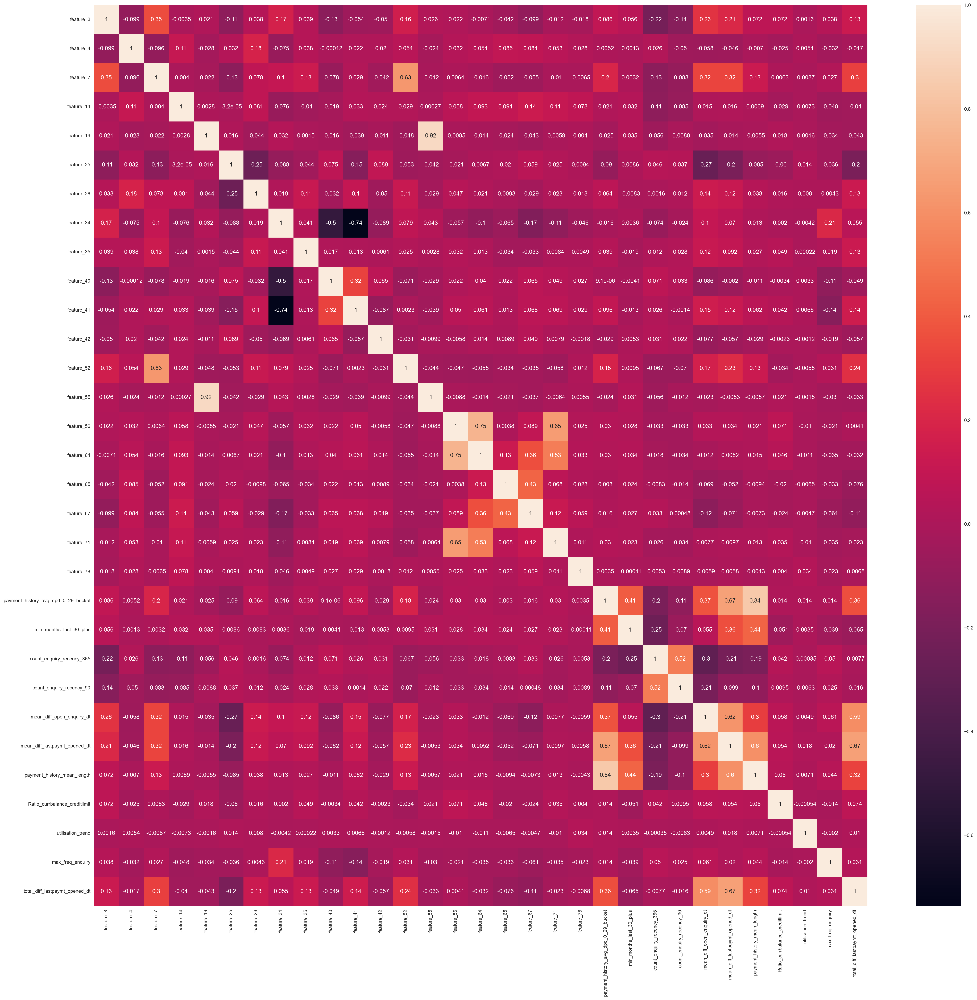

In [119]:
plt.figure(figsize=(32, 32), dpi = 200)
sns.heatmap( X_train[numcols].corr(), annot  = True)

In [120]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything else
# without any other insight.

def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr




In [121]:
corr_features = correlation(X_train[numcols], 0.8)
corr_features

{'feature_55', 'payment_history_mean_length'}

In [122]:
X_train.drop(corr_features, axis = 1, inplace = True)
X_test.drop(corr_features, axis = 1, inplace = True)

In [123]:
numcols.remove('feature_55')
numcols.remove('payment_history_mean_length')
                             

# Model-2
## Feature matrix - List of features selected with gain


In [124]:
# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=200, random_state=0, n_jobs=-1)

# Train the classifier
clf.fit(X_train, y_train)

# Print the name and gini importance of each feature
for feature in zip(X_train.columns, clf.feature_importances_):
    print(feature)

('feature_3', 0.06543812864356512)
('feature_4', 0.012490219190246952)
('feature_7', 0.0682513788915533)
('feature_11', 0.006669626181602018)
('feature_14', 0.010607421327058619)
('feature_19', 0.005342526069442919)
('feature_23', 0.007547891604321676)
('feature_25', 0.010774890002524929)
('feature_26', 0.01902275362777702)
('feature_33', 0.00643326114575545)
('feature_34', 0.006730283400896833)
('feature_35', 0.045762305696907514)
('feature_40', 0.03477732598635418)
('feature_41', 0.03156456521169605)
('feature_42', 0.005451808468921079)
('feature_50', 0.0070158727382295255)
('feature_52', 0.028567473987064933)
('feature_56', 0.01751872291824179)
('feature_64', 0.023812444124158987)
('feature_65', 0.0379755273099017)
('feature_67', 0.006116945575071972)
('feature_71', 0.02209750139221824)
('feature_72', 0.010427363742250038)
('feature_78', 0.00444852735487943)
('payment_history_avg_dpd_0_29_bucket', 0.06514774224159)
('min_months_last_30_plus', 0.046040271103911005)
('count_enquiry_re

<Axes: >

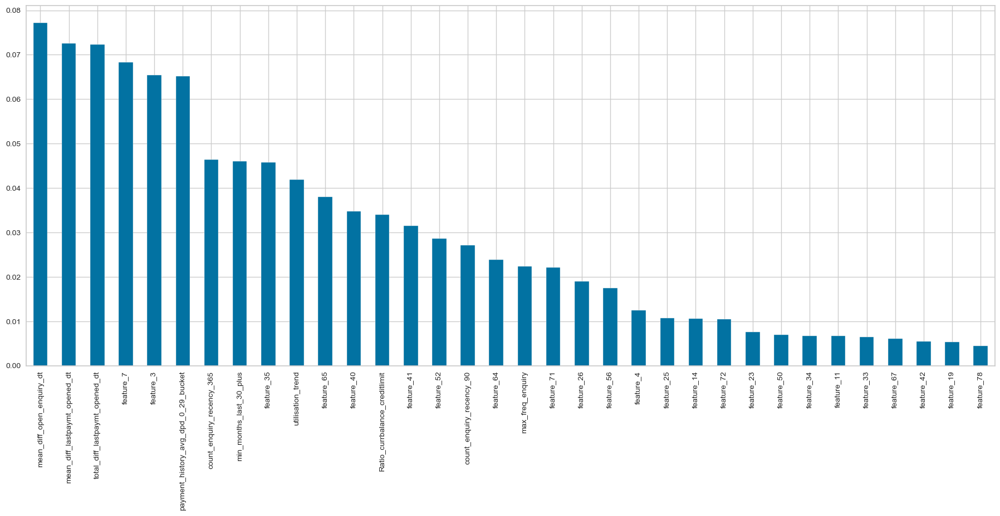

In [125]:
importances = clf.feature_importances_

Gain = pd.Series(importances)
Gain.index = X_train.columns
Gain.sort_values(ascending=False).plot.bar(figsize=(20, 8))

## Recursive feature elimination (feature_selection techinique)

### Matthews Correlation Coefficient (MCC):

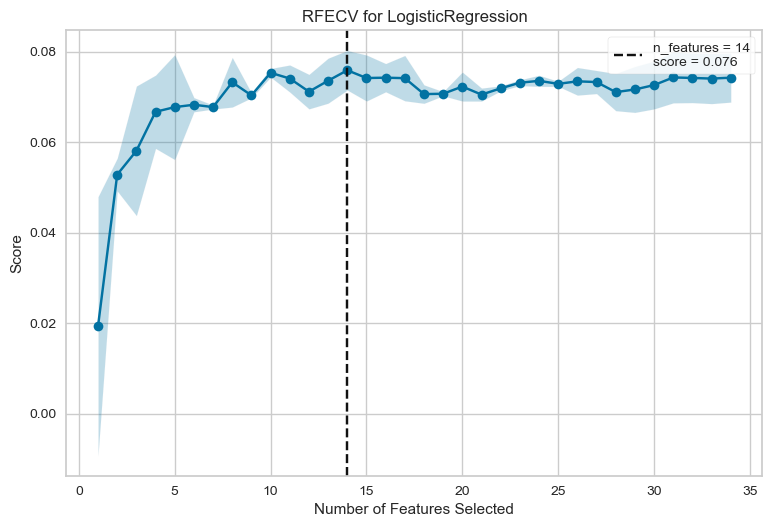

<Axes: title={'center': 'RFECV for LogisticRegression'}, xlabel='Number of Features Selected', ylabel='Score'>

In [127]:
from sklearn.metrics import make_scorer
mcc_scorer = make_scorer(matthews_corrcoef)
rfecv = RFECV(estimator=LogisticRegression(random_state = 42, class_weight='balanced', C=200, dual=False, solver='liblinear', n_jobs=-1),
              cv=StratifiedKFold(2),
              scoring =  mcc_scorer)
rfecv.fit(X_train, y_train.values.ravel())
rfecv.show() 

In [128]:
mask = rfecv.get_support()
columns = X_train.columns
selected_cols = columns[mask]
n_features5 = len(selected_cols)
X_train_rfe = pd.DataFrame(rfecv.transform(X_train), columns = selected_cols)
X_test_rfe = pd.DataFrame(rfecv.transform(X_test), columns = selected_cols)

# Model Evaluation

### Cross validation

Model is not the one that gives accurate predictions on the training data, but the one which gives good predictions on the new data and avoids overfitting and underfitting


Cross-validation is a resampling procedure used to evaluate machine learning models on a limited data sample. The procedure has a single parameter called k that refers to the number of groups that a given data sample is to be split into. As such, the procedure is often called k-fold cross-validation.

The purpose of cross–validation is to test the ability of a machine learning model to predict new data.

###  Stratified K-Fold CV (Cross-Validation)

Stratification is used when the datasets contain unbalanced classes. Therefore if we cross-validate with a normal technique it may produce subsamples that have a varying distribution of classes. Some unbalanced samples may produce exceptionally high scores leading to a high cross-validation score overall, which is undesirable. Therefore we create stratified subsamples that preserve the class frequencies in the individual folds to ensure that we are able to get a clear picture of the model performance.

### Sampling is not recommanded before Cross validation


If you want to undersample or oversample your data you shouldn't do it before cross validating because you will be directly influencing the validation set before implementing cross-validation causing a "data leakage" problem.

Exactly like we should do feature selection inside the cross validation loop, we should also oversample inside the loop.



In [129]:
#We are going to ensure that we have the same splits of the data every time. 
#We can ensure this by creating a KFold object, kf, and passing cv=kf instead of the more common cv=5.

kf = StratifiedKFold(n_splits=5, shuffle=False)

In [130]:
rf = RandomForestClassifier()

### Best Metrics is used for imbalanced dataset

#### Terms:
<ul>
<li><b>True Positives:</b> Correctly Classified Fraud Transactions </li>
<li><b>False Positives:</b> Incorrectly Classified Fraud Transactions</li>
<li> <b>True Negative:</b> Correctly Classified Non-Fraud Transactions</li>
<li> <b>False Negative:</b> Incorrectly Classified Non-Fraud Transactions</li>
<li><b>Precision: </b>  True Positives/(True Positives + False Positives)  </li>
<li><b> Recall: </b> True Positives/(True Positives + False Negatives)   </li>
<li> Precision as the name says, says how precise (how sure) is our model in detecting fraud transactions while recall is the amount of fraud cases our model is able to detect.</li>
<li><b>Precision/Recall Tradeoff: </b> The more precise (selective) our model is, the less cases it will detect. Example: Assuming that our model has a precision of 95%, Let's say there are only 5 fraud cases in which the model is 95% precise or more that these are fraud cases. Then let's say there are 5 more cases that our model considers 90% to be a fraud case, if we lower the precision there are more cases that our model will be able to detect. </li>
</ul>

#### We need to focus on 1 – Customer has Bad credit history

So, <b> Recall </b>  is the best metric to know the Customer has Bad credit history


Recall: The ability of a model to find all the relevant cases within a data set. The number of true positives divided by the number of true positives    plus the number of false negatives.

In most high-risk detection cases (like cancer), recall is a more important evaluation metric than precision.

In the case of credit card fraud detection, we want to avoid false negatives as much as possible. Fraud transactions cost us a lot and thus we want to take appropriate measures to prevent them. A false negative case means that a fraud-positive transaction is assessed to genuine transaction, which is detrimental. In this use case, false positives (a genuine transaction as fraud-positive) are not as important as preventing a fraud.

### with undersampling

In [131]:
from imblearn.under_sampling import NearMiss
nm = NearMiss(version=1, n_neighbors=3)

# Resample the dataset
X_res, y_res = nm.fit_resample(X_train_rfe, y_train)

## Logistic Regression

In [132]:
lr = LogisticRegression(class_weight='balanced', C=200, dual=False, solver='liblinear', n_jobs=-1)
lr.fit(X_res, y_res)
lr_preds = lr.predict(X_test_rfe)
print(classification_report(y_test, lr_preds))

              precision    recall  f1-score   support

           0       0.96      0.23      0.37      3844
           1       0.04      0.81      0.08       165

    accuracy                           0.25      4009
   macro avg       0.50      0.52      0.22      4009
weighted avg       0.93      0.25      0.36      4009



In [133]:
recall_score(y_test, lr_preds)

0.806060606060606

## Random Forest Classifier

In [135]:
rf = RandomForestClassifier()
rf.fit(X_res, y_res)
rf_preds = rf.predict(X_test_rfe)

In [136]:
recall_score(y_test, rf_preds)

0.8303030303030303

### Hyper parameter tuning Logistic Regression

In [138]:
lr = LogisticRegression(class_weight='balanced', solver='liblinear', n_jobs=-1)


param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'penalty': ['l1', 'l2'],
    'max_iter': [100, 200, 300]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(lr, param_grid, cv=5, scoring='f1', n_jobs=-1)
grid_search.fit(X_res, y_res)

# Get the best model
best_lr = grid_search.best_estimator_

# Print the best hyperparameters found
print("Best Hyperparameters:", grid_search.best_params_)

# Predict on the test set using the best model
lr_preds = best_lr.predict(X_test_rfe)

# Print classification report
print(classification_report(y_test, lr_preds))

Best Hyperparameters: {'C': 10, 'max_iter': 100, 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.96      0.23      0.37      3844
           1       0.04      0.81      0.08       165

    accuracy                           0.25      4009
   macro avg       0.50      0.52      0.22      4009
weighted avg       0.93      0.25      0.36      4009



###  Hyperparameter Tuning Using GridSearchCV(RandomForest Classifier)

In [139]:
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [50, 100, 200],
    'max_depth': [4, 6, 10, 12],
    'random_state': [13]
}


### Imbalanced-Learn Pipeline

The purpose of the pipeline is to assemble several steps that can be cross-validated together while setting different parameters.

During the cross-validation process we should split into training and validation segments. Then, on each segment, we should:

1. Undersample the majority class.
2. Train the classifier on the training segment.
3. Validate the classifier on the remaining segment.

In [140]:
from imblearn.pipeline import Pipeline, make_pipeline
undersample_pipeline = make_pipeline(NearMiss(version = 1, n_neighbors=3), 
                              RandomForestClassifier(n_estimators=100, random_state=13))

In [141]:
new_params = {'randomforestclassifier__' + key: params[key] for key in params}
grid_over_rf = GridSearchCV(undersample_pipeline, param_grid=new_params, cv=kf, scoring='recall',
                        return_train_score=True)
grid_over_rf.fit(X_train_rfe, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('nearmiss', NearMiss()),
                                       ('randomforestclassifier',
                                        RandomForestClassifier(random_state=13))]),
             param_grid={'randomforestclassifier__max_depth': [4, 6, 10, 12],
                         'randomforestclassifier__n_estimators': [50, 100, 200],
                         'randomforestclassifier__random_state': [13]},
             return_train_score=True, scoring='recall')

In [142]:
print('Best parameters:', grid_over_rf.best_params_)
print('Best score:', grid_over_rf.best_score_)

Best parameters: {'randomforestclassifier__max_depth': 10, 'randomforestclassifier__n_estimators': 100, 'randomforestclassifier__random_state': 13}
Best score: 0.8093643198906356


In [143]:
y_pred = grid_over_rf.best_estimator_.named_steps['randomforestclassifier'].predict(X_test_rfe)

In [144]:
cm = confusion_matrix(y_test, y_pred)

over_rf_Recall = recall_score(y_test, y_pred)
over_rf_Precision = precision_score(y_test, y_pred)
over_rf_f1 = f1_score(y_test, y_pred)
over_rf_accuracy = accuracy_score(y_test, y_pred)

recall_score(y_test, y_pred)

0.8242424242424242

## Neural Nets

In [145]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.models import Sequential

### Model_1

In [146]:
weights_assigned = {0: 1, 1: 10}


In [147]:
model_1 = Sequential()
# define first hidden layer and visible layer
model_1.add(Dense(50, input_dim=14, activation='relu', kernel_initializer='he_uniform'))
# define output layer (it prevents overfitting)
model_1.add(Dense(1, activation='sigmoid'))
# define loss and optimizer
model_1.compile(loss='binary_crossentropy', optimizer='adam')
model_1.fit(X_train_rfe,y_train,class_weight=weights_assigned,epochs=10)

Epoch 1/10
502/502 [==============================] - 2s 2ms/step - loss: 0.8774
Epoch 2/10
502/502 [==============================] - 1s 2ms/step - loss: 0.8232
Epoch 3/10
502/502 [==============================] - 1s 2ms/step - loss: 0.8101
Epoch 4/10
502/502 [==============================] - 1s 2ms/step - loss: 0.8037
Epoch 5/10
502/502 [==============================] - 1s 2ms/step - loss: 0.7963
Epoch 6/10
502/502 [==============================] - 1s 2ms/step - loss: 0.7930
Epoch 7/10
502/502 [==============================] - 1s 2ms/step - loss: 0.7892
Epoch 8/10
502/502 [==============================] - 1s 2ms/step - loss: 0.7864
Epoch 9/10
502/502 [==============================] - 1s 2ms/step - loss: 0.7840
Epoch 10/10
502/502 [==============================] - 1s 2ms/step - loss: 0.7809


In [149]:
y_pred=model_1.predict(X_test_rfe)

126/126 [==============================] - 0s 2ms/step


In [150]:
from sklearn.metrics import roc_auc_score

In [151]:
roc_auc_score(y_test,y_pred)

0.636395169173525

### Model_2

In [152]:
model_2 = Sequential()


model_2.add(Dense(100, input_dim=14, activation='relu', kernel_initializer='he_uniform'))
model_2.add(BatchNormalization())  # Batch normalization layer
model_2.add(Dropout(0.5))  # Dropout layer with a dropout rate of 0.5


model_2.add(Dense(50, activation='relu', kernel_initializer='he_uniform'))
model_2.add(BatchNormalization())  # Batch normalization layer
model_2.add(Dropout(0.5))  # Dropout layer with a dropout rate of 0.5

model_2.add(Dense(1, activation='sigmoid'))


model_2.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])


model_2.fit(X_train_rfe, y_train, epochs=10, class_weight=weights_assigned)


Epoch 1/10
502/502 [==============================] - 4s 4ms/step - loss: 1.0762 - accuracy: 0.6878
Epoch 2/10
502/502 [==============================] - 2s 3ms/step - loss: 0.9062 - accuracy: 0.8342
Epoch 3/10
502/502 [==============================] - 2s 4ms/step - loss: 0.8456 - accuracy: 0.8729
Epoch 4/10
502/502 [==============================] - 2s 3ms/step - loss: 0.8296 - accuracy: 0.8942
Epoch 5/10
502/502 [==============================] - 2s 3ms/step - loss: 0.8146 - accuracy: 0.9101
Epoch 6/10
502/502 [==============================] - 2s 3ms/step - loss: 0.8140 - accuracy: 0.9129
Epoch 7/10
502/502 [==============================] - 2s 3ms/step - loss: 0.8042 - accuracy: 0.9206
Epoch 8/10
502/502 [==============================] - 2s 3ms/step - loss: 0.8129 - accuracy: 0.9220
Epoch 9/10
502/502 [==============================] - 2s 3ms/step - loss: 0.8057 - accuracy: 0.9213
Epoch 10/10
502/502 [==============================] - 2s 3ms/step - loss: 0.8061 - accuracy: 0.9212

In [153]:
y_pred=model_2.predict(X_test_rfe)

126/126 [==============================] - 0s 2ms/step


In [154]:
roc_auc_score(y_test,y_pred)

0.6620360735345125

###Model_3

In [156]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.models import Sequential
from sklearn.utils.class_weight import compute_class_weight

# Compute class weights
class_labels = np.unique(y_train)
class_weights = compute_class_weight('balanced', classes=class_labels, y=y_train)
class_weights = {class_labels[i]: class_weights[i] for i in range(len(class_weights))}

model_3 = Sequential()
model_2.add(Dense(100, input_dim=14, activation='relu', kernel_initializer='he_uniform'))
model_2.add(BatchNormalization())  # Batch normalization layer
model_2.add(Dropout(0.5))  # Dropout layer with a dropout rate of 0.5


model_3.add(Dense(50, activation='relu', kernel_initializer='he_uniform'))
model_3.add(BatchNormalization())  # Batch normalization layer
model_3.add(Dropout(0.5))  # Dropout layer with a dropout rate of 0.5


model_3.add(Dense(1, activation='sigmoid'))


model_3.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Fit the model with class weights
model_3.fit(X_train_rfe, y_train, epochs=10, class_weight=class_weights)


Epoch 1/10
502/502 [==============================] - 3s 3ms/step - loss: 0.8649 - accuracy: 0.4991
Epoch 2/10
502/502 [==============================] - 1s 2ms/step - loss: 0.7475 - accuracy: 0.5391
Epoch 3/10
502/502 [==============================] - 1s 3ms/step - loss: 0.7076 - accuracy: 0.5705
Epoch 4/10
502/502 [==============================] - 1s 3ms/step - loss: 0.6806 - accuracy: 0.5703
Epoch 5/10
502/502 [==============================] - 1s 3ms/step - loss: 0.6772 - accuracy: 0.5663
Epoch 6/10
502/502 [==============================] - 1s 3ms/step - loss: 0.6677 - accuracy: 0.5766
Epoch 7/10
502/502 [==============================] - 1s 3ms/step - loss: 0.6643 - accuracy: 0.5796
Epoch 8/10
502/502 [==============================] - 1s 3ms/step - loss: 0.6661 - accuracy: 0.5915
Epoch 9/10
502/502 [==============================] - 1s 3ms/step - loss: 0.6666 - accuracy: 0.6033
Epoch 10/10
502/502 [==============================] - 1s 3ms/step - loss: 0.6636 - accuracy: 0.6131

In [157]:
y_pred=model_3.predict(X_test_rfe)

126/126 [==============================] - 0s 2ms/step


In [158]:
roc_auc_score(y_test,y_pred)

0.6533140983193013